# TRABAJO 1: ENSEMBLE LEARNING | MACHINE LEARNING II
## Feb 2023
--- 

### GRUPO: G3
- Enrique Gil García
- Blanca Gómez Pérez
- María José Medina Hernández
- Ana Rotella Fernández
- Marta Simón Pinacho

--- 

**IMPORTANTE:**
- Asegúrate, fijando la semilla de los nº aleatorios según proceda, que si se vuelve a ejecutar el cuaderno los resultados son idénticos
- Responde a las preguntas planteadas utilizando instrucciones "print" que permitan leer cómodamente como resultado de la ejecución de la celda el texto explicativo junto a las figuras o tablas a las que haga referencia (mira el ejemplo en la primera gráfica que se representa). También puedes usar markdown para responder.
- No escribas líneas de código muy largas, tienes una regla para ayudarte a no hacerlo
- No cambies la estructura del documento, respeta las secciones que ya existen


---
Importamos todos los paquetes aquí por comodidad

In [1]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_text
from mltools import model_tools as MT
from sklearn import metrics
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from mltools import classification_tools as CT
from sklearn.inspection import permutation_importance

from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import math

from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, GradientBoostingClassifier, VotingClassifier, StackingClassifier
from sklearn.ensemble import GradientBoostingClassifier
from imblearn.pipeline import make_pipeline as imbalanced_make_pipeline
from imblearn.over_sampling import SMOTE

import pickle

import warnings
warnings.filterwarnings("ignore")

### 1. AJUSTE DE LOS MODELOS CON EL DATASET AJU_DATOS_DEM_C3

Se trata de estimar la variable FESTIVO (1: el día es festivo) a partir de las variables disponibles en el dataset que se consideren oportunas. NO se pueden utilizar como variables de entrada: FECHA, DIA ni ANNO. La FECHA es interesante manejarla simplemente como ayuda para entender lo que esté pasando.

Se deben ajustar diferentes modelos, buscando un buen compromiso entre la complejidad y el error en cada uno de ellos. El objetivo es conseguir un buen modelo con una gran capacidad de acierto en el futuro. Modelos que deben crearse, analizando los resultados de cada uno de ellos (errores e importancias de las variables):
- Simple tree
- Bagged  tree
- Random Forest
- Gradient boosting
- Stacking

Carga de datos

In [3]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

def read_data():
    df_aju = pd.read_csv('AJU_DATOS_DEM_C3.csv')

    # parseamos la fecha (cadena) para que sea un datetime con formato dd/mm/yyyy 
    # esta variable NO se puede utilizar como entrada en los modelos
    df_aju.FECHA = pd.to_datetime(df_aju.FECHA, format='%d/%m/%Y') 
    s=df_aju.loc[:,'FECHA']
    df_aju['FECHA'] =  s.dt.date

    # eliminamos las variables que no se pueden usar como entradas en los modelos
    del df_aju['ANNO']
    del df_aju['DIA']
    return df_aju

df_aju = read_data()

print('Tamaño de df_orig con los datos cargados:', df_aju.shape)
print('Dataframe con todos los datos leidos (filas: días, columnas: variables):')
df_aju

Tamaño de df_orig con los datos cargados: (2879, 30)
Dataframe con todos los datos leidos (filas: días, columnas: variables):


,FECHA,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,...,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,FESTIVO,TMIN,TMAX
0,2014-01-01,0.040942,0.038985,0.036382,0.034416,0.033409,0.033420,0.034054,0.034229,0.035889,...,0.055197,0.054185,0.051063,0.046240,0.041000,1,3,1,12.3,20.2
1,2014-01-02,0.033950,0.030996,0.029517,0.028966,0.029165,0.030150,0.032944,0.036510,0.041196,...,0.055820,0.054451,0.051482,0.046145,0.040880,1,4,0,12.0,20.1
2,2014-01-03,0.035463,0.032112,0.030292,0.029521,0.029450,0.030515,0.033188,0.036656,0.041052,...,0.055230,0.053520,0.050286,0.045412,0.040025,1,5,0,13.2,21.0
3,2014-01-04,0.035959,0.032772,0.031034,0.030178,0.030135,0.030782,0.032598,0.034982,0.039299,...,0.053757,0.052620,0.049973,0.044970,0.040386,1,6,0,14.4,23.4
4,2014-01-05,0.037506,0.034148,0.031878,0.031126,0.030930,0.031604,0.033066,0.034803,0.038758,...,0.052902,0.051481,0.049655,0.045730,0.040905,1,7,0,12.8,23.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2874,2021-12-27,0.033180,0.031299,0.030173,0.029493,0.029649,0.030814,0.033925,0.037837,0.042098,...,0.051685,0.050563,0.047267,0.042237,0.037797,12,1,0,16.1,23.0
2875,2021-12-28,0.033823,0.031731,0.030385,0.029950,0.030017,0.031203,0.034708,0.038432,0.042645,...,0.051867,0.050971,0.047718,0.042585,0.037774,12,2,0,16.6,22.7
2876,2021-12-29,0.034475,0.032198,0.030902,0.030441,0.030384,0.031487,0.034454,0.038381,0.042850,...,0.052136,0.050604,0.046788,0.042033,0.037595,12,3,0,14.3,21.3
2877,2021-12-30,0.034345,0.031919,0.030524,0.029991,0.030087,0.031286,0.034384,0.038574,0.042778,...,0.052092,0.050993,0.047587,0.042807,0.038252,12,4,0,13.4,26.4


Visión general de las series

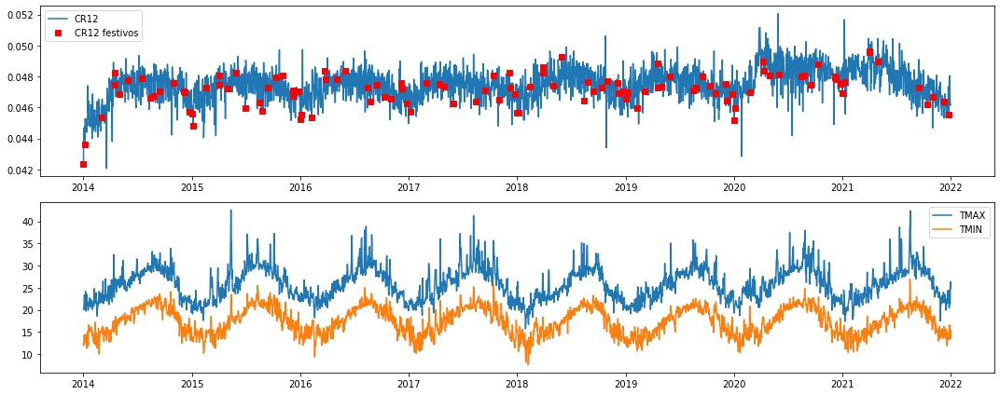

Se observa que el nº de festivos (115) es claramente inferior al nº de laborables (2764)
En concreto, el porcentaje de festivos en el conjunto de ajuste es 3.99444251476207 %


In [91]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
fig = plt.figure(1, figsize=(15,6))
ax1 = plt.subplot(2,1,1)

ind_festivo = df_aju.FESTIVO == 1

plt.plot(df_aju.FECHA, df_aju.CR12, label='CR12')

plt.plot(df_aju.FECHA[ind_festivo], df_aju.CR12[ind_festivo], 'sr', label='CR12 festivos')
plt.legend()

plt.subplot(2,1,2,sharex= ax1)
plt.plot(df_aju.FECHA, df_aju.TMAX, label='TMAX')
plt.plot(df_aju.FECHA, df_aju.TMIN, label='TMIN')
plt.tight_layout()
plt.legend()

plt.show()

num_festivos = np.count_nonzero(df_aju.FESTIVO)
num_laborables = df_aju.shape[0] - num_festivos
print(f'Se observa que el nº de festivos ({num_festivos}) es claramente inferior al nº de laborables ({num_laborables})')
print(f'En concreto, el porcentaje de festivos en el conjunto de ajuste es {100*num_festivos /  df_aju.shape[0]} %')
# fig.savefig('figura1.pdf')

---
### 1.1 Análisis exploratorio básico del problema

- Incluye un análisis que te permita comprender la naturaleza del problema, cómo son las variables de entrada, su interrelación, así como su relación con la variable de salida
- Comenta todo lo que parezca relevante para el tema tratado, incluyendo todas las gráficas que consideres oportunas
- Estudia cómo se reparten los festivos según el día de la semana y los meses

In [92]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
#Primero convertimos la variable de salida en category
df_aju['FESTIVO'] = df_aju['FESTIVO'].astype('category')

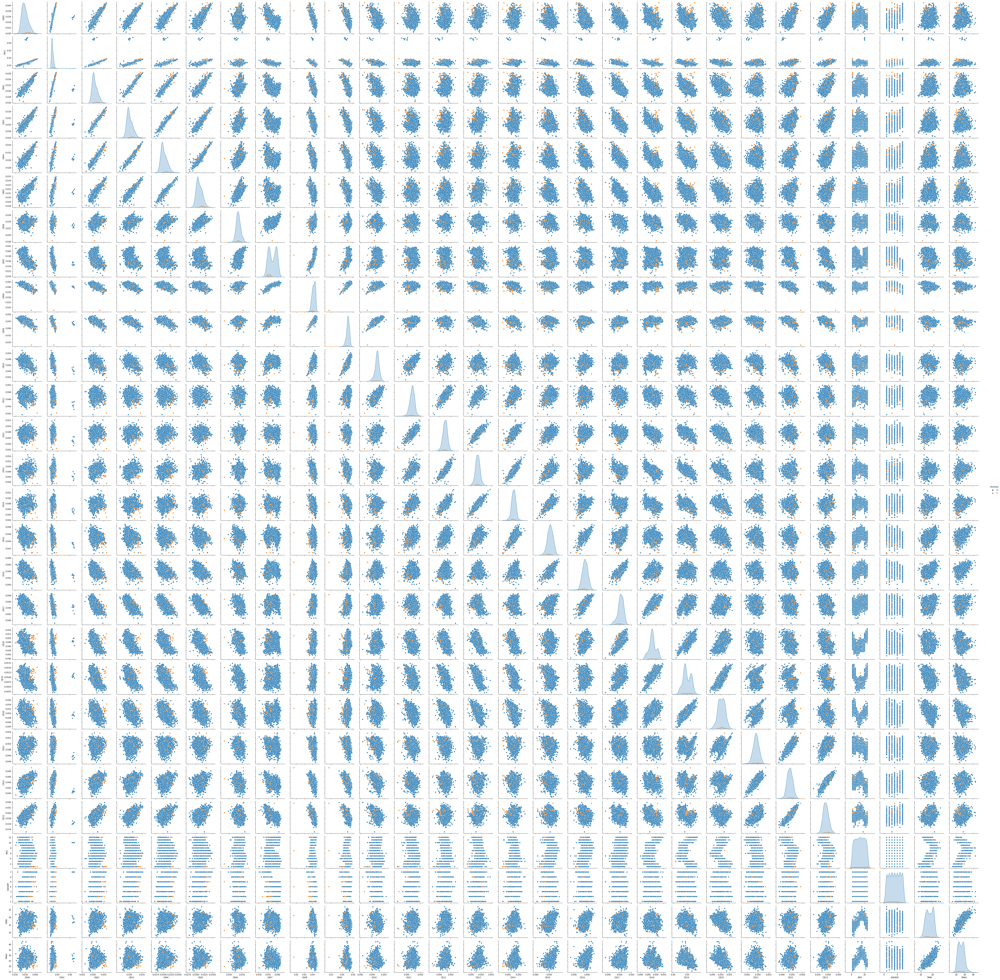

In [93]:
sns.pairplot(df_aju, hue="FESTIVO")

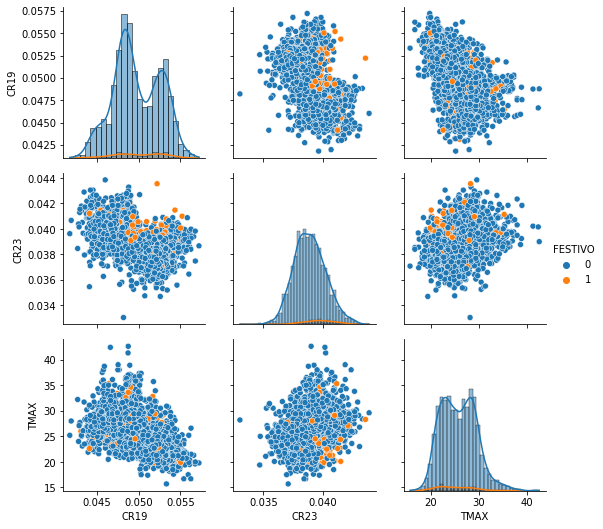

In [94]:
# Focus on interesting variables
g = sns.PairGrid(df_aju, vars=["CR19", "CR23","TMAX"], hue="FESTIVO")
g.map_diag(sns.histplot, kde=True)
g.map_offdiag(sns.scatterplot)
g.add_legend()

Al tener clases tan desbalanceadas se hace un poco dificil apreciar qué variable podria clasificar mejor a simple vista, ya que la mayoria de puntos que vemos en el scatter plot son azules, que son los dias que no son festivos. Además, como ya mencionaremos mas adelante, no hay ninguna variable que tenga una relacion alta con la variable de salida. 

Al ser un problema de clasificación y al tener tener tantas variables, hemos hecho graficas sólamente de aquellas tres variables que sospechamos que pueden separar los dos tipos de clase (festivo y no festivo), esas son CR19,CR23 y TMAX.

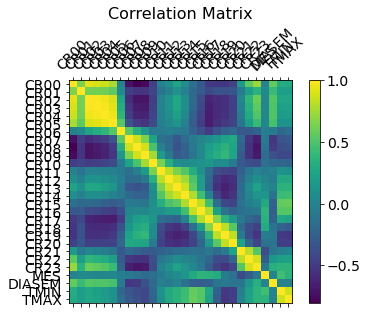

In [95]:
### Exploratory analysis -------------------------------------------------------------------------------------
#correlation plot of numeric variables
f = plt.figure()
plt.matshow(df_aju.select_dtypes(include=['int64','float64']).corr(), fignum=f.number)
plt.xticks(range(df_aju.select_dtypes(include=['int64','float64']).shape[1]), df_aju.select_dtypes(include=['int64','float64']).columns, fontsize=14, rotation=45)
plt.yticks(range(df_aju.select_dtypes(include=['int64','float64']).shape[1]), df_aju.select_dtypes(include=['int64','float64']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16)
plt.show()

In [96]:
df_aju.corr()

,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,CR09,...,CR18,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,TMIN,TMAX
CR00,1.000000,0.649143,0.924715,0.892032,0.860473,0.767746,0.004409,-0.721845,-0.806965,-0.759511,...,-0.516594,-0.535506,-0.452476,0.166705,0.541708,0.722006,-0.005375,0.568827,0.310718,0.297573
CR01,0.649143,1.000000,0.624885,0.615096,0.605932,0.553999,0.044173,-0.470424,-0.529553,-0.536335,...,-0.349983,-0.349859,-0.324765,-0.055107,0.195872,0.347357,0.054423,0.414960,0.198179,0.205916
CR02,0.924715,0.624885,1.000000,0.979619,0.955395,0.887785,0.235442,-0.573455,-0.713695,-0.712224,...,-0.578024,-0.561563,-0.464948,0.014528,0.376458,0.594505,0.026376,0.516022,0.255317,0.252257
CR03,0.892032,0.615096,0.979619,1.000000,0.978747,0.920995,0.310423,-0.520807,-0.667190,-0.677042,...,-0.593601,-0.563694,-0.464139,-0.015224,0.337686,0.555233,0.025375,0.504434,0.222252,0.223928
CR04,0.860473,0.605932,0.955395,0.978747,1.000000,0.954225,0.374179,-0.474611,-0.616910,-0.631394,...,-0.582644,-0.543472,-0.454088,-0.039213,0.300114,0.512880,0.017059,0.508255,0.178878,0.184403
CR05,0.767746,0.553999,0.887785,0.920995,0.954225,1.000000,0.524099,-0.345934,-0.495345,-0.527366,...,-0.553492,-0.507898,-0.434821,-0.101760,0.206940,0.408313,0.021452,0.470761,0.113313,0.122762
CR06,0.004409,0.044173,0.235442,0.310423,0.374179,0.524099,1.000000,0.546517,0.334508,0.134935,...,-0.349632,-0.250586,-0.195737,-0.309131,-0.298799,-0.226559,-0.027390,-0.069316,-0.197738,-0.156116
CR07,-0.721845,-0.470424,-0.573455,-0.520807,-0.474611,-0.345934,0.546517,1.000000,0.868325,0.641257,...,0.148874,0.237888,0.282117,-0.191226,-0.513312,-0.649214,-0.068658,-0.518938,-0.330253,-0.300040
CR08,-0.806965,-0.529553,-0.713695,-0.667190,-0.616910,-0.495345,0.334508,0.868325,1.000000,0.876163,...,0.275925,0.351540,0.258847,-0.234825,-0.540730,-0.694788,-0.121456,-0.499927,-0.382115,-0.357476
CR09,-0.759511,-0.536335,-0.712224,-0.677042,-0.631394,-0.527366,0.134935,0.641257,0.876163,1.000000,...,0.315482,0.387928,0.247627,-0.296883,-0.550756,-0.674168,-0.165874,-0.355954,-0.425298,-0.419720


Aqui estamos estudiando la relación que tienen las variables, unas con otras, ademas de con la salida. Algunos puntos interesantes a destacar son:

- Hay varias variables de entrada que están bastante correlacionadas entre ellas, como por ejemplo CR00 y CR02 con una correlacion de 0.979. Esto quiere decir que una puede explicar a la otra y que, a la hora de hacer nuestro modelo, podemos llegar a descartar una de ellas como input ya que la otra nos estaría aportando la misma información. Otros ejemplos de correlaciones altas son CR03 y CR04 o CR02 y CR00. Por otro lado, tambien hemos encontrado variables que estaban alta pero inversamente correlacionadas como CR00 y CR08 con una correlacion igual a -0.806.

- La interpretación que podemos sacar de la confusion matrix es que las variables que están muy correlacionadas son aquellas horas que están muy seguidas entre ellas, esto se debe a que es muy probable que lo que se esté haciendo a las 3 de la mañana también se esté haciendo a las 4, como por ejemplo, dormir. Sin embargo, si nos fijamos en la correlacion altamente negativa que hemos comentado antes entre CR00 y CR12, puede deberse a que, a las 02 una persona en general suele estar durmiendo y, a las 08, levantándose para ir a trabajar.

#### Prepara los conjuntos de entrenamiento y test

- Divide los datos disponibles de ajuste (df_aju) en dos conjuntos diferentes (TR:80% y TS: 20%). TS lo deberías de utilizar para validar la calidad de los diferentes modelos que se creen.
- Recuerda fijar una semilla para garantizar que la separación es reproducible

In [4]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# Crea dos dataframes df_aju_tr y df_aju_ts y trabaja con ellos

def split_dataset():
    
    # Define input and output matrices
    INPUTS = df_aju.columns[~df_aju.columns.isin(['FESTIVO', 'FECHA'])]
    OUTPUT = 'FESTIVO'
    X = df_aju[INPUTS]
    y = df_aju[OUTPUT]

    # Split
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.2,  #percentage of test data
                                                        random_state=0, #seed for replication
                                                        stratify = y)   #Preserves distribution of y
    return INPUTS, OUTPUT, X_train, X_test, y_train, y_test

INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()
# # Crea dos dataframes df_aju_tr y df_aju_ts y trabaja con ellos
# df_aju_tr = X_train.copy()
# df_aju_tr['FESTIVO'] = y_train # We will call Y as output variable for simplicity
# df_aju_ts = X_test.copy()
# df_aju_ts['FESTIVO'] = y_test # We will call Y as output variable for simplicity>

#### 1.2. Ajusta un modelo de clasificación sencillo que sea robusto y que pueda servir de referencia de comparación con otros modelos más complejos.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Analiza la lógica que emplea para determinar si es festivo
- Revisa la importancia de las variables

In [98]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
## Inputs of the model. Change accordingly to perform variable selection
INPUTS_DT = INPUTS

# Cuanto mas grande sea el min_impurity_decrease, mas sencillo va a ser mi árbol (es un hyperparameter)
param = {'DT__min_impurity_decrease': np.arange(0,0.05,0.005)} # Minimum entropy to decrease in each split
pipe = Pipeline(steps=[('scaler', StandardScaler()), 
                       ('DT', DecisionTreeClassifier(criterion='gini',  # impuriry measure - también se puede utilizar "entropy"
                                                     min_samples_split=5, # Minimum number of obs in node to keep cutting
                                                     min_samples_leaf=5, # Minimum number of obs in a terminal node
                                                     random_state=150))]) # For replication

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
tree_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
tree_fit.fit(X_train[INPUTS_DT], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('DT',
                                        DecisionTreeClassifier(min_samples_leaf=5,
                                                               min_samples_split=5,
                                                               random_state=150))]),
             n_jobs=-1,
             param_grid={'DT__min_impurity_decrease': array([0.   , 0.005, 0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 ,
       0.045])},
             scoring='accuracy')

In [99]:
# Show the best grid parameter combination found by CV
tree_fit.best_estimator_['DT'].get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 5,
 'min_samples_split': 5,
 'min_weight_fraction_leaf': 0.0,
 'random_state': 150,
 'splitter': 'best'}

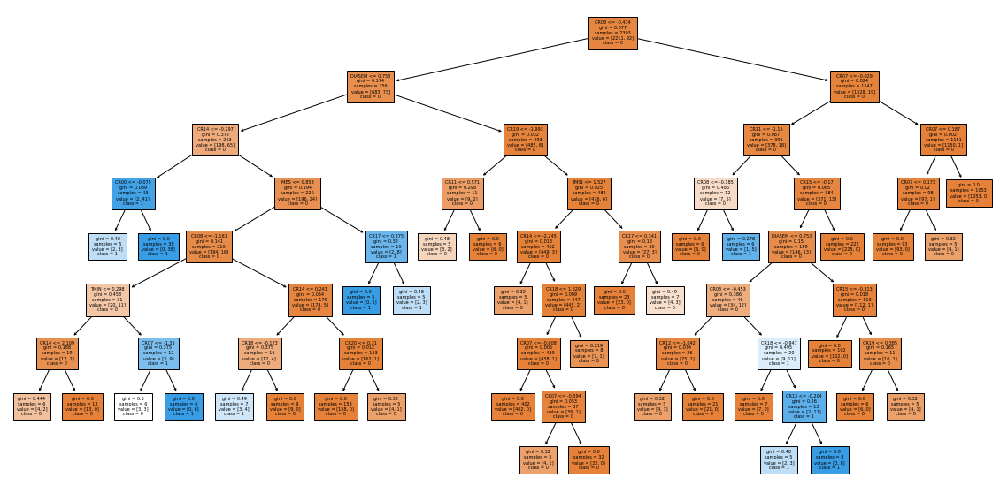

In [100]:
## Plot the decision tree model (use figsize and fontsize for getting the best view)
plt.figure(figsize=(20, 10))
plot_tree(tree_fit.best_estimator_['DT'], # Utiliza los parámetros óptimos obtenidos de la búsqueda de la cuadrícula
          feature_names= INPUTS_DT, # Lista de variables utilizadas en el modelo
          class_names= [str(s) for s in y_train.unique()], # Lista de nombres de las clases objetivo en el modelo
          fontsize=5, # Tamaño de fuente utilizado en la visualización del árbol
          filled=True) # Las cajas del árbol se colorearán según la mayoría de la clase objetivo
plt.show()

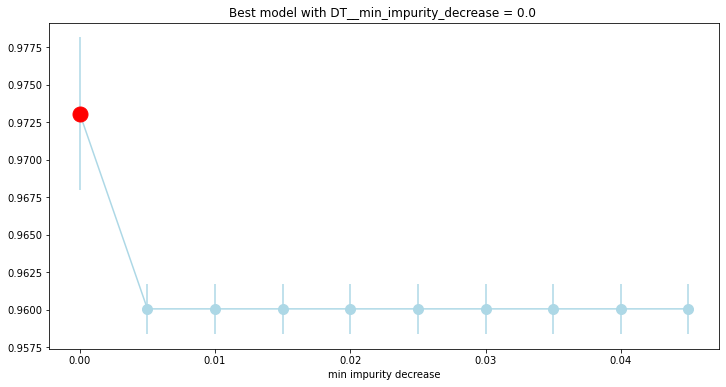

In [101]:
MT.plotModelGridError(tree_fit)

El valor mas optimo del parametro min_impurity_decrease es igual a 0, lo que significa que se permiten todas las divisiones que reducen la impureza, incluso si la reducción es muy pequeña. Al establecer un valor mínimo de min_impurity_decrease, podemos limitar el crecimiento del árbol y evitar el sobreajuste.El valor mas optimo del parametro min_impurity_decrease es igual a 0 

In [102]:
clf = tree_fit.best_estimator_['DT']
y_train_pred = clf.predict(X_train[INPUTS_DT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_DT]).tolist()

# main metrics
# Se calcula la precisión y la precisión equilibrada
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

# Se crean las confusion matrixs
print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1, 0])

                         TR        TS
Accuracy           0.960052  0.960069
Balanced accuracy  0.500000  0.500000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1  0   92
         0  0 2211

Accuracy: 0.96
No Information Rate: 0.96
P-Value [Acc > NIR]: 0.53
Kappa: 0.0
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  0  23
         0  0 553

Accuracy: 0.96
No Information Rate: 0.96
P-Value [Acc > NIR]: 0.56
Kappa: 0.0
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1


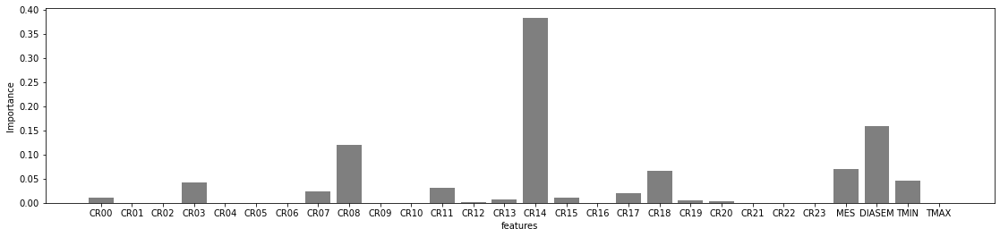

In [103]:
## Plot the variable importance of each feature
plt.figure(figsize=(19, 4))
bar_width = 0.35
plt.bar(INPUTS_DT, tree_fit.best_estimator_['DT'].feature_importances_, color='black', alpha=0.5)
plt.xlabel('features')
plt.ylabel('Importance')
plt.show()

Una vez realizado nuestro primer arbol podemos indicar los siguientes puntos:
- Este primer modelo no es un modelo muy bueno ya que aunque tengamos una accuracy de 0.96 tanto en trainning como en test esto se debe a tener clases tan desbalanceadas. Si nos fijamos en la confusion matrix, el modelo no es capaz de encontrar ni un solo dia que sea festivo, no ha sido capaz de distinguir bien. En este tipo de casos, es más correcto fijarse en el balanced accuracy que es de 0.5 que significa que al final la clasificación la está haciendo casi de manera aleatoria.
- Por otro lado el sensitivity mide la capacidad del modelo para identificar correctamente todos los casos positivos, que en este caso son los dias no festivos y por eso el sensitivity es igual a 1, porque los identifica todos. Por el contrario, la especificidad mide la capacidad del modelo para identificar correctamente todos los casos negativos y en este caso tiene sentido que sea igual a 0 ya que no está identificando los dias festivos. Otro punto que refuerza que nuestro modelo no tiene buen rendimiento es que el F1 Score es igual a 0

- Podriamos decir que la variable mas importante en este modelo es CR14 con una gran diferencia con respecto las demas y despues les siguen DIASEM, CR08 y MES

La capacidad de generación de un árbol de decisión se puede verificar mediante la evaluación del rendimiento del modelo en un conjunto de prueba que no se utilizó durante el entrenamiento. Hemos repetido este procedimiento varias veces para ver si podriamos mejorar el arbol y con el min_impurity_decrease igual a 0 hemos llegado al mas optimo pero podriamos llegar a mejorarlo si quitamos alguna varaible de entrada pero la mejora no seria muy grande ya que el arbol es capaz de distinguir que variables son las mas importantes para hacer las predicciones.

In [104]:
from imblearn.under_sampling import RandomUnderSampler
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV, train_test_split



from imblearn.pipeline import make_pipeline as imbalanced_make_pipeline
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state = 11)
X_train_SMOTE, y_train_SMOTE = smote.fit_resample(X_train, y_train)

# Define pipeline with SMOTE to balance classes
pipe_balanced = imbalanced_make_pipeline(DecisionTreeClassifier(criterion='gini',
                                                                 class_weight='balanced',
                                                                 min_samples_split=5, 
                                                                 min_samples_leaf=5, 
                                                                 random_state=150))

# Fit the balanced pipeline
pipe_balanced.fit(X_train_SMOTE[INPUTS_DT], y_train_SMOTE)

Pipeline(steps=[('decisiontreeclassifier',
                 DecisionTreeClassifier(class_weight='balanced',
                                        min_samples_leaf=5, min_samples_split=5,
                                        random_state=150))])

In [105]:
# Make predictions on the training and test sets
y_train_pred2 = pipe_balanced.predict(X_train_SMOTE[INPUTS_DT]).tolist()
y_test_pred2 = pipe_balanced.predict(X_test[INPUTS_DT]).tolist()

# Calculate the accuracy and balanced accuracy scores
acc_tr2 = metrics.accuracy_score(y_train_SMOTE, y_train_pred2)
acc_ts2 = metrics.accuracy_score(y_test, y_test_pred2)
acc_bal_tr2 = metrics.balanced_accuracy_score(y_train_SMOTE, y_train_pred2)
acc_bal_ts2 = metrics.balanced_accuracy_score(y_test, y_test_pred2)

# Print the accuracy and balanced accuracy scores
dfacc = pd.DataFrame(
    [[acc_tr2, acc_ts2], [acc_bal_tr2, acc_bal_ts2]],
    index=['Accuracy', 'Balanced accuracy'],
    columns=['TR', 'TS'])
print(dfacc)

# Se crean las confusion matrixs
print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train_SMOTE, y_train_pred2, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred2, labels=[1, 0]) 

                         TR        TS
Accuracy           0.992311  0.961806
Balanced accuracy  0.992311  0.813429

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference    1    0
         1 2194   17
         0   17 2194

Accuracy: 0.99
No Information Rate: 0.5
P-Value [Acc > NIR]: 0.0
Kappa: 0.98
Mcnemar's Test P-Value: 1.0
Sensitivity: 0.99
Specificity: 0.99
Precision: 0.99
Recall: 0.99
Prevalence: 0.5
Detection Rate: 0.5
Detection prevalence: 0.5
Balanced accuracy: 0.99
F1 Score: 0.99
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 15   8
         0 14 539

Accuracy: 0.96
No Information Rate: 0.91
P-Value [Acc > NIR]: 0.47
Kappa: 0.56
Mcnemar's Test P-Value: 0.29
Sensitivity: 0.97
Specificity: 0.65
Precision: 0.52
Recall: 0.65
Prevalence: 0.96
Detection Rate: 0.94
Detection prevalence: 0.95
Balanced accuracy: 0.81
F1 Score: 0.58
Positive label: 1


Aqui hemos balanceado las dos clases y hemos mejorado un poquito mas el modelo sin embargo hay overfitting ya que el f1 score en training es 0.99 y en test 0.63. Pero podemos decir que este segundo decision tree es mejor que el primero.

#### 1.3. Ajusta un bagged tree para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

**Optimiza la complejidad**

Para optimizar la complejidad en primer lugar he ejecutado el siguiente código para buscar el número óptimo de árboles de decisión que usaremos en el modelo de ensamble, utilizando la técnica de Bagging.

El GridSearchCV realiza una búsqueda exhaustiva de los parámetros en el rango especificado y devuelve el mejor valor para el parámetro n_estimators, que maximiza la precisión del modelo.

In [106]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
base_estimator =  Pipeline(steps=[('DT', 
                                    DecisionTreeClassifier( criterion='gini',  
                                                            min_samples_split=2, 
                                                            min_samples_leaf=1, 
                                                            random_state=999))]) 

In [107]:
# find optim nº of trees in the ensemble
param = {'BT__n_estimators': range(20, 150, 5)} # Rango del nº de árboles a usar en el ensamble

pipe =  Pipeline(steps=[('BT', 
                            BaggingClassifier(base_estimator=base_estimator,
                                              random_state=150))])

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
bt_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
# fit the bagged trees
INPUTS_BT = INPUTS  
bt_fit.fit(X_train[INPUTS_BT], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('BT',
                                        BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                                                          DecisionTreeClassifier(random_state=999))]),
                                                          random_state=150))]),
             n_jobs=-1, param_grid={'BT__n_estimators': range(20, 150, 5)},
             scoring='accuracy')

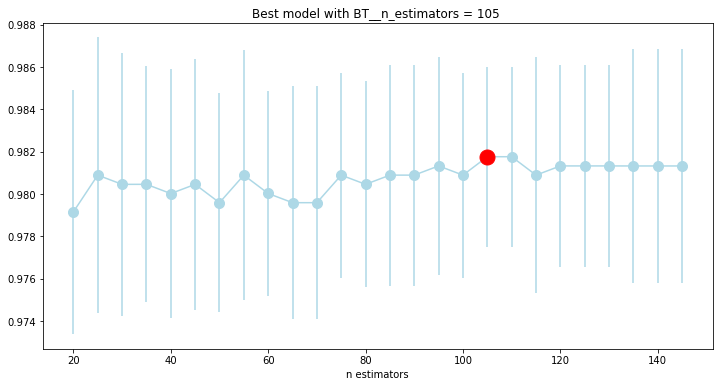

In [108]:
MT.plotModelGridError(bt_fit)

**Revisar los errores de Tr y TS**

- **F1 score**

El F1 score es una medida de la precisión de un modelo de clasificación. Representa la media armónica entre la precisión (la proporción de instancias clasificadas como positivas que son verdaderamente positivas) y la exhaustividad o recall (la proporción de instancias positivas que son identificadas correctamente por el modelo). 

En este caso, un F1 score de 1.0 en los datos de entrenamiento indica que el modelo clasificó todas las instancias de manera correcta en el conjunto de entrenamiento, lo que sugiere que el modelo se ajusta muy bien a los datos de entrenamiento.

Por otro lado, un F1 score de 0.78 en los datos de prueba indica que el modelo no clasificó todas las instancias de manera correcta en el conjunto de prueba, lo que sugiere que el modelo no generaliza tan bien a datos nuevos como lo hizo en los datos de entrenamiento. Sin embargo, un F1 score de 0.78 sigue siendo bastante alto y sugiere que el modelo tiene un rendimiento aceptable en el conjunto de prueba.

Es importante tener en cuenta que el modelo podría estar sobreajustando a los datos de entrenamiento, lo que significa que está demasiado ajustado a los datos específicos de entrenamiento y no generaliza bien a nuevos datos. Por esta razón, volveremos a entrenar el modelo reajustando los parámetros para hacerlo menos flexible y que generalice correctamente.

- **Balanced accuracy**

En este escenario, al tener las clases desbalanceadas, el uso de la exactitud (accuracy) simple como medida de la calidad del modelo puede ser engañoso, ya que el modelo podría tener un alto porcentaje de predicciones correctas para la clase mayoritaria, pero fallar en la clase minoritaria.

En cambio, para evaluar el rendimiento del modelo de manera más justa y precisa, hemos utilizado la balanced accuracy como medida de calidad del modelo.

En su caso, un valor de 1.0 de balanced accuracy en los datos de entrenamiento sugiere que el modelo está clasificando correctamente todas las instancias en ambas clases. Por otro lado, un valor de 0.846018 de balanced accuracy en los datos de prueba sugiere que el modelo no está clasificando correctamente todas las instancias en ambas clases, y que su rendimiento es ligeramente peor en los datos de prueba que en los datos de entrenamiento. 

Esto puede ser una indicación de que el modelo está sobreajustando a los datos de entrenamiento, algo que también hemos comprobado en el F1 score de train y de test.

- **Precision**

La precisión es una medida de la calidad de un modelo de clasificación que mide la proporción de instancias positivas (ejemplos que el modelo predice como positivos) que son verdaderamente positivas (ejemplos que pertenecen a la clase positiva). 

Un valor de precisión de 1 en el conjunto de entrenamiento indica que el modelo se ajusta bien a los datos de entrenamiento, mientras que un valor de precisión de 0.89 en el conjunto de prueba indica que el modelo tiene un buen rendimiento en el conjunto de prueba, pero podría haber margen de mejora para predecir correctamente instancias positivas. Este márgen en train y test no es muy grande en comparación con F1 score y Balanced accuracy, pero sigue habiendo diferencia.

- **Recall**

El recall (exhaustividad) es una medida de la calidad de un modelo de clasificación que mide la proporción de instancias positivas (ejemplos que pertenecen a la clase positiva) que se predicen correctamente.

un valor de recall de 1 en el conjunto de entrenamiento indica que el modelo se ajusta bien a los datos de entrenamiento, mientras que un valor de recall de 0.7 en el conjunto de prueba indica que el modelo tiene un buen rendimiento en el conjunto de prueba, pero tiene una diferencia de 0.3 en train y en test, lo que indica claramente que hay overfitting.

In [109]:
# model predictions in training (TR) and test (TS) sets
# Usa el modelo "bt_fit" que se entrenó previamente para hacer predicciones en train y test
clf = bt_fit
y_train_pred = clf.predict(X_train[INPUTS_BT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_BT]).tolist()

# main metrics 
# Calcula la exactitud
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)
# Calcula la exactitud equilibrada
acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1, 0])

                    TR        TS
Accuracy           1.0  0.984375
Balanced accuracy  1.0  0.846018

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 92    0
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  2 551

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.77
Mcnemar's Test P-Value: 0.18
Sensitivity: 1.0
Specificity: 0.7
Precision: 0.89
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.78
Positive label: 1


**Matriz de confusión**

La matriz de confusión es una tabla que se utiliza para evaluar el rendimiento de un modelo de clasificación. La matriz de confusión muestra el número de instancias que se clasifican correctamente y el número de instancias que se clasifican incorrectamente para cada clase.

Vamos a fijarnos en la matriz de confusión con los valores normalizados, ya que de esta forma podremos ver en porcentajes la cantidad de datos clasificados correctamente para ambas clases.

Lo ideal es que los valores más altos (incluso valores de 1 mejor), se sitúen en la diagonal principal, que se encuentran los verdaderos positivos y los verdaderos negativos. En el training podemos ver que esta clasificando correctamente el 100% de los datos, ya que tiene un 1 en VP y un 1 en VN.

Por otra parte, en la matriz de confusión de test, vemos que ha clasificado perfectamente todos los verdaderos positivos, ya que tiene un 1. Sin embargo, de los verdaderos negativos ha clasificado bien el 70% (una diferencia del 30% con el train), esto significa, comparándolo con las otras métricas, que el modelo tiene overfitting.

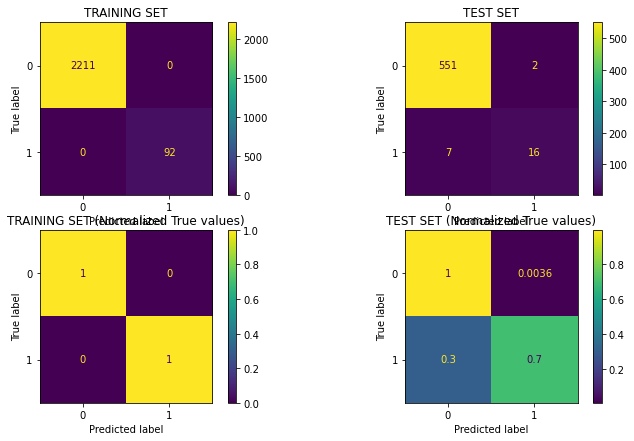

In [110]:
fig = plt.figure(figsize=(12, 7))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

**Revisar la importancia de las variables**

In [111]:
d = bt_fit.best_params_
n_estimators = d['BT__n_estimators']

bag_class_estim = BaggingClassifier(base_estimator=base_estimator,
                                    n_estimators=n_estimators,
                                    random_state=0)
                     
# fit the bagged trees
INPUTS_BT = INPUTS  
bag_class_estim.fit(X_train[INPUTS_BT], y_train)

BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                  DecisionTreeClassifier(random_state=999))]),
                  n_estimators=105, random_state=0)

**Importancia de las variables**

El gráfico generado a continuación muestra la variabilidad de la importancia de las características (features) en el conjunto de árboles que hemos entrenado en el modelo (bagged trees).

La línea horizontal muestra la mediana de la distribución de cada árbol, mientras que los bordes superior e inferior de la caja representan el percentil 75 y 25 de la distribución respectivamente.

Además, también está mostrando la importancia media de cada característica en todos los árboles del ensamblado, que se muestra como una línea azul que conecta los puntos de la importancia media de cada característica.

Con esta información podemos concluir determinando las características más importantes para el modelo basado en las decisiones de cara árbol. En este caso son las características CR14, CR15 y DIASEM, que son las que tienen una mayor media en comparación con el resto.

Tambien podemos ver que todas las características poseen outliers por encima del límite superior (percentil 75).

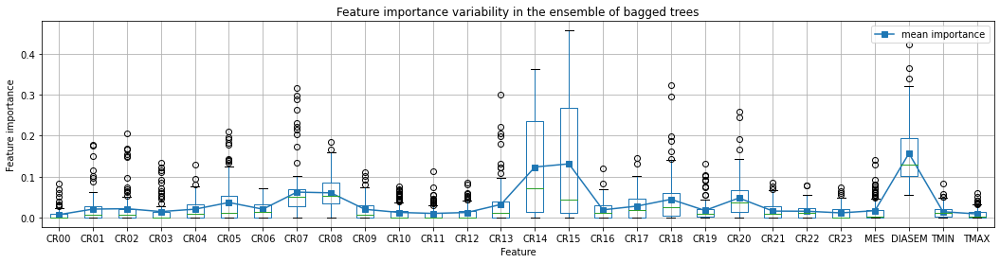

In [112]:
# feature importances of each tree in the ensemble
# Contiene la importancia de cada característica en cada uno de los árboles.
feature_importances_trees = [t['DT'].feature_importances_ for t in bag_class_estim.estimators_]

# global view of feature importances
dfimp =  pd.DataFrame(list(feature_importances_trees), columns=INPUTS_BT)
dfimp.boxplot(figsize=(18, 4))
plt.plot(np.arange(len(INPUTS_BT))+1, dfimp.mean(),'s-', label ='mean importance')
plt.ylabel('Feature importance') 
plt.xlabel('Feature') 
plt.title('Feature importance variability in the ensemble of bagged trees')
plt.legend()
plt.show()

**Guardamos el modelo de Bagged tree**

In [113]:
# Guardamos el modelo entrenado para agilizar la parte de validación
filename = "./models/bagged_tree_v1.pickle"
# # save model
pickle.dump(bt_fit.best_estimator_['BT'], open(filename, "wb"))

#### Volvemos a entrenar el modelo para tratar de eliminar el overfitting realizando un modelo más sencillo

**Optimizamos la complejidad**

- **criterion**: cambiarlo a 'entropy' puede reducir la complejidad del modelo.
- **min_samples_split**: si aumento este valor significará que se requieren más muestras para que se produzca una división en un nodo interno del árbol, dando lugar a un modelo más sencillo.
- **min_samples_leaf**: si aumento este valor, significa que se requerirán más muestras para formar una hoja del árbol, dando lugar a un modelo mas sencillo.
- **number_estimators**: además, he decidido asignar manualmente el número de árboles que vamos a entrenar, teniendo en cuenta de que antes el más óptimo era 105, voy a disminuirlo a la mitad (50 árboles) y comprobar si el resultado mejora.

In [114]:
number_estimators = 50 # El número de árboles que vamos a entrenar
base_estimator =  Pipeline(steps=[('DT', 
                                    DecisionTreeClassifier( criterion='entropy',  # impurity measure
                                                            min_samples_split=4, # Número mínimo de observaciones en un nodo para seguir dividiendolo
                                                            min_samples_leaf=3, # Número mínimo de observaciones en un nodo hoja (terminal)
                                                            random_state=999))]) # For replication


bag_class_estim = BaggingClassifier(base_estimator=base_estimator,
                                    n_estimators=number_estimators,
                                    random_state=0)
                     
# fit the bagged trees
INPUTS_BT = INPUTS
bag_class_estim.fit(X_train[INPUTS_BT], y_train)

BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                  DecisionTreeClassifier(criterion='entropy',
                                                                         min_samples_leaf=3,
                                                                         min_samples_split=4,
                                                                         random_state=999))]),
                  n_estimators=50, random_state=0)

**Revisamos los errores de TR y TS**

- **F1 score**

Como ya hemos mencionado, el F1 score es una medida de la precisión de un modelo de clasificación. En este caso el modelo nos ha devuelto un F1 score de 0.94 en train y de 0.8 en test. En comparación al modelo anterior, ha disminuido el valor de train (antes era 1), por lo tanto, disminuyendo el overfitting. Por otra parte, ha aumentado el valor en test de 0.78 a 0.8, lo que nos indica que el modelo ha mejorado. Seguimos analizando y comparando métricas para cerciorarnos de esta afirmación.

- **Balanced accuracy**

Seguiremos haciendo uso de la balanced accuracy por tener las clases desbalanceadas, que ya ha sido explicando en detalle previamente. En este segundo modelo, hemos obtenido un balanced accuracy en train de  0.945652, ha disminuido en comparación con el primer modelo (1.0), dando lugar a una disminución del overfitting. En cuanto al balanced accuracy en test, hemos obtenido un valor de 0.846922 que en comparación con el resultado obtenido en el primer modelo (0.846018), ha mejorado pero son resultados muy similares.

- **Precision**

La precisión es una medida de la calidad del modelo de clasificación. En este modelo hemos obtenido una precisión en train de 1.0, el mismo valor que en el modelo anterior, sin embargo, en el conjunto de datos de test hemos obtenido una precisión de 0.94, que en comparación con el primer modelo ha mejorado en un 0.05. Al aumentar la precisión en test, vemos que ya no hay tanto margen entre los resultados de train y test, lo que significa que el overfitting se ha reducido.

- **Recall**

El recall, también es una medida de la calidad de un modelo de clasificación. En este modelo hemos obtenido un recall en train de 0.89, ha diminuido con respecto al primer modelo (1.0). En cuanto al recall de test, se ha mantenido, sigue estando en 0.7. El modelo ha mejorado en este aspecto, porque aun que el recall de test se haya mantenido, en train ha diminuido, disminuyendo también el overfitting.


En **resumen**, este segundo modelo una vez analizadas las métricas podemos concluir diciendo que ha mejorado en comparación con el primero permitiendo la reducción del overfitting y la mejora de las métricas de precisión y de calidad en test.


In [115]:
clf = bag_class_estim
y_train_pred = clf.predict(X_train[INPUTS_BT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_BT]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1, 0])

                         TR        TS
Accuracy           0.995658  0.986111
Balanced accuracy  0.945652  0.846922

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 82   10
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.94
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.89
Precision: 1.0
Recall: 0.89
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 0.95
F1 Score: 0.94
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  1 552

Accuracy: 0.99
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.79
Mcnemar's Test P-Value: 0.07
Sensitivity: 1.0
Specificity: 0.7
Precision: 0.94
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.8
Positive label: 1


**Matriz de confusión**

En cuanto a la matriz de confusión, podemos evaluar si el rendimiento del modelo de clasificación ha mejorado o no. Vamos a volver a fijarnos en la matriz de confusión con los valores normalizados.

En cuanto a la diagonal principal donde se encuentran los verdaderos positivos y los verdaderos negativos, en la parte de train podemos ver que se han clasificado correctamente el 100% de los valores de verdaderos positivos. Sin embargo, el porcentaje de verdaderos negativos en este caso ha disminuido a 0.89 (en el modelo anterior era 1.0), lo que significa que está clasificando correctamente el 89% de los verdaderos negativos, esto se puede explicar como una disminución del overfitting en el modelo.

En cuanto a la otra matriz de confusión referida al conjunto de test podemos ver que al igual que en el modelo anterior ha clasificado casi el 100% de los datos correctamente de los verdaderos positivos. Además, en los falsos positivos antes estaba clasificando erróneamente el 0.0036, ahora a disminuido a 0,0018, es una diferencia muy pequeña pero no deja de significar una disminución de la clasificación errónea de los falsos positivos. En cuanto a los verdaderos negativos y falsos negativos, este modelo ha clasificado estos datos de la misma forma que el modelo anterior, ni ha mejorado ni ha empeorado

Una vez explicado esto, podemos concluir con la idea ya explicada, el modelo ha mejorado lijeramente y ha disminuido el overfitting en comparación con el modelo anterior.

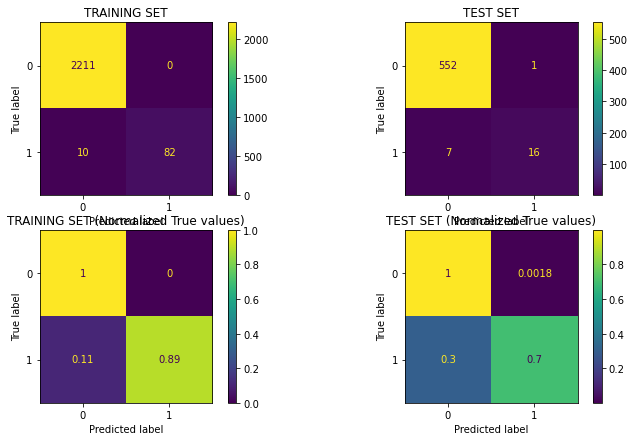

In [116]:
fig = plt.figure(figsize=(12, 7))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

**Importancia de las variables**

El gráfico generado a continuación muestra la variabilidad de la importancia de las características (features) en el conjunto de árboles que hemos entrenado en el modelo (bagged trees), como ya hemos explicado.

En este modelo, se han determinado como características más importantes la CR15, DIASEM (al igual que en el modelo anterior), CR07 y CR08. En este modelo no se le ha dado mucha importancia a la variable CR14, en el modelo anterior sí. Esto se debe a la aleatoriedad en la selección de subconjuntos de datos y características en cada modelo. 

Al igual que en el modelo anterior, podemos ver que todas las características poseen outliers por encima del límite superior (percentil 75).

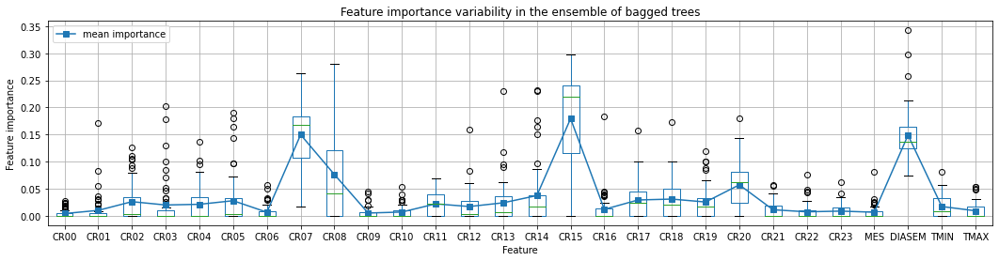

In [117]:
# feature importances of each tree in the ensemble
# Contiene la importancia de cada característica en cada uno de los árboles.
feature_importances_trees = [t['DT'].feature_importances_ for t in bag_class_estim.estimators_]

# global view of feature importances
dfimp =  pd.DataFrame(list(feature_importances_trees), columns=INPUTS_BT)
dfimp.boxplot(figsize=(18, 4))
plt.plot(np.arange(len(INPUTS_BT))+1, dfimp.mean(),'s-', label ='mean importance')
plt.ylabel('Feature importance') 
plt.xlabel('Feature') 
plt.title('Feature importance variability in the ensemble of bagged trees')
plt.legend()
plt.show()

**Guardamos el modelo de Bagged tree versión 2**

In [118]:
filename = "./models/bagged_tree_v2.pickle"
pickle.dump(bag_class_estim, open(filename, "wb"))

#### 1.4. Ajusta un random forest para resolver el problema planteado.

- **Optimiza la complejidad**
- **Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación**
- **Revisa la importancia de las variables**

In [119]:
# Leemos los datos y los preparamos para el modelo
df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

Comenzamos entrenando un modelo de Random Forest utilizando la técnica de GridSearch.

En primer lugar, realizamos un Grid Search de todos los parámetros del modelo, incluimos entre los parámetros a probar, los siguientes valores:
+ RF__max_features: [1 - 27]
+ RF__n_estimators: [1 - 100]
+ RF__min_samples_split: [1 - 20]
+ min_samples_leaf: [1 - 10]

Una vez encontramos una buena combinación de hiperparámetros, nos enfocamos en optimizar los parámetros `min_samples_split` y `min_samples_leaf` con valores fijos para min_samples_split=6 y min_samples_leaf=1, que fueron los que mejor resultado dieron en el entrenamiento inicial.

Además, añadimos como configuración el parámetro `class_weight='balanced'`. Este parámetro ajusta automáticamente los pesos de las clases en función de su frecuencia en los datos de entrenamiento. Esto significa que las clases menos representadas tendrán un mayor peso en el modelo, lo que puede ayudar a evitar el sobreajuste y mejorar la precisión, ya que, como hemos visto, en nuestro dataset hay un desequilibrio notable entre las dos clases.

In [120]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# find optim nº of trees in the ensemble and max_features
param = {'RF__max_features': range(5, 26, 1), # Number number of features to consider when looking for the best split
         'RF__n_estimators': range(20, 100, 5), # Number of trees in the forest
         } 

pipe =  Pipeline(steps=[('RF', 
                            RandomForestClassifier(
                                        criterion='gini',  # impurity measure
                                        class_weight='balanced', # Weights associated with classes
                                        min_samples_split=6, # Minimum number of obs in node to keep cutting
                                        min_samples_leaf=1, # Minimum number of obs in a terminal node  
                                        random_state=0)
                        )])

# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
rf_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='f1', # F1 https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
# fit the bagged trees
INPUTS_RF = INPUTS  
rf_fit.fit(X_train[INPUTS_RF], y_train) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('RF',
                                        RandomForestClassifier(class_weight='balanced',
                                                               min_samples_split=6,
                                                               random_state=0))]),
             n_jobs=-1,
             param_grid={'RF__max_features': range(5, 26),
                         'RF__n_estimators': range(20, 100, 5)},
             scoring='f1')

El grid search realizado se ha centrado en optimizar el scoring de F1, puesto que las clases están desbalanceadas. El F1 Score es una métrica que se utiliza para medir la precisión general de un modelo de aprendizaje automático en función de su capacidad para identificar tanto los resultados positivos como los negativos. Cuanto mayor sea el F1 Score, mejor será el rendimiento del modelo. A continuación vamos a calcular todas las métricas del modelo entrenado, para detectar si hemos conseguido generar un modelo que consiga generalizar lo suficiente como para identificar ambas clases.

Además del F1, podemos fijarnos en el balanced accuracy, una métrica muy útil a la hora de tratar con datasets desbalanceados.

Una vez entrenado el modelo, lo almacenamos en formato pickle para poder reutilizarlo sin tener que entrenarlo de nuevo.

In [121]:
# Guardamos el modelo entrenado para agilizar la parte de validación
filename = "./models/random_forest.pickle"
# # save model
pickle.dump(rf_fit.best_estimator_['RF'], open(filename, "wb"))

En las gráficas siguientes, se puede observar la optimización de hiperparámetros que se ha realizado mediante el GridSearch anterior. En este caso vemos que los mejores hiperparámetros son `max_features = 22` y `n_estimators = 80`.

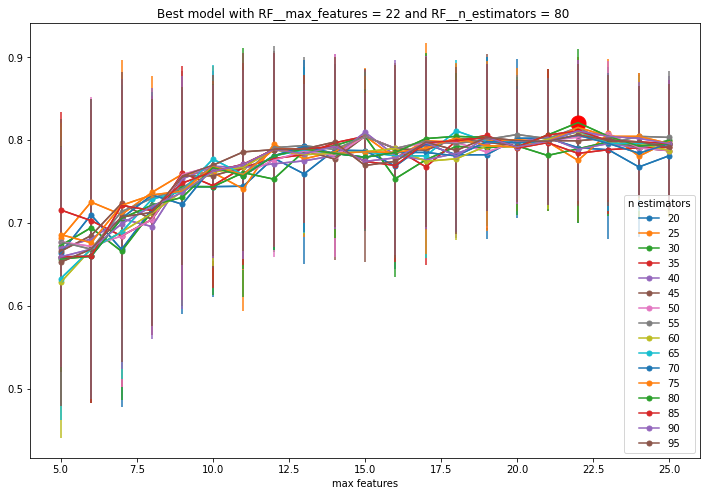

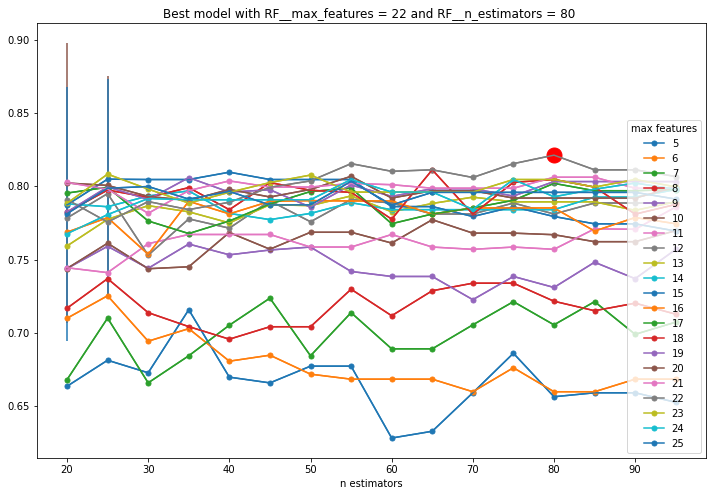

In [122]:
MT.plotModelGridError(rf_fit)

In [123]:
# Almacenamos en una variable el mejor modelo encontrado por GridSearchCV
RF_class_estim = rf_fit.best_estimator_['RF']

A continuación se incluyen las gráficas que indican la importancia que le ha dado el modelo Random Forest a cada una de las variables del dataset.

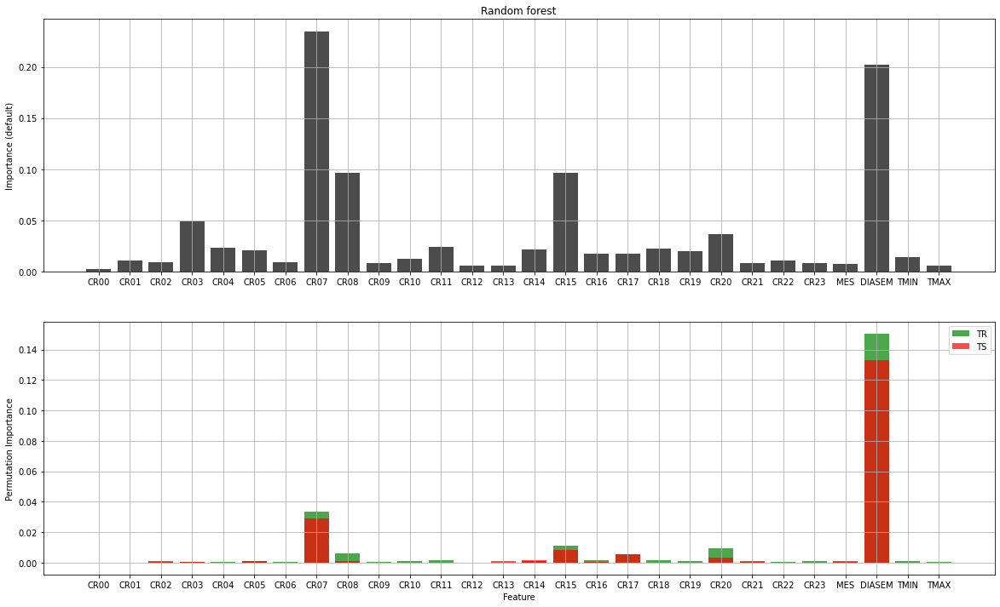

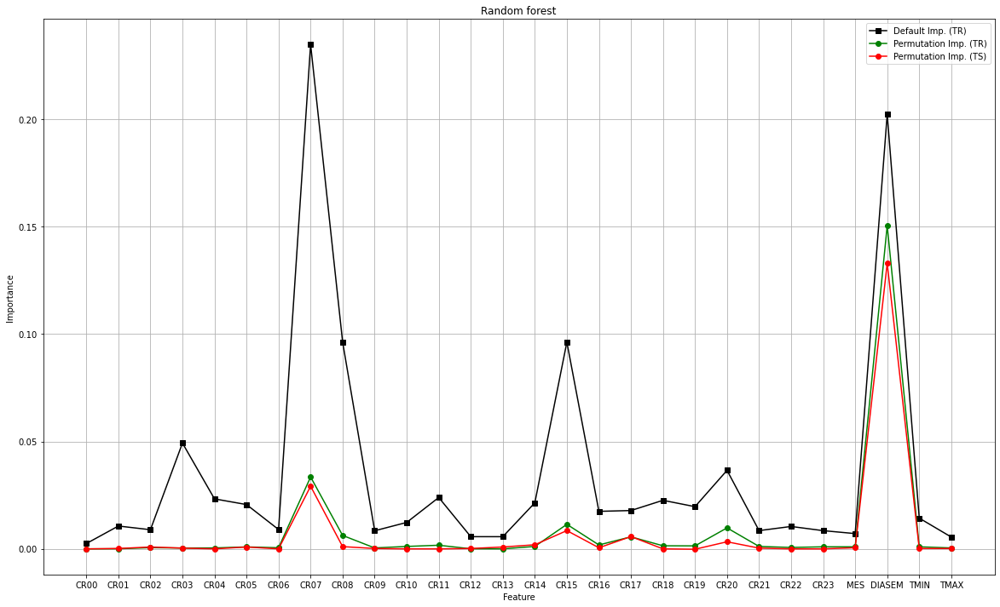

In [124]:
# Importancia de las variables de entrada en el modelo
## Feature importance evaluation using "Permutation Importance" (training and test)
importances_tr_RF_class_estim = permutation_importance(RF_class_estim, 
                                    X_train[INPUTS_RF], y_train,
                                    n_repeats=10,
                                    random_state=0)

importances_ts_RF_class_estim = permutation_importance(RF_class_estim, 
                                    X_test[INPUTS_RF], y_test,
                                    n_repeats=10,
                                    random_state=0)
 
## Plot importances

# Plot the variable importance of each feature given by feature_importances_ attribute
plt.figure(figsize=(20, 12))

plt.subplot(2,1,1)
plt.bar(INPUTS_RF, RF_class_estim.feature_importances_, color='black', alpha=0.7)
plt.ylabel('Importance (default)')
plt.title('Random forest')
plt.grid()

plt.subplot(2,1,2)
plt.bar(INPUTS_RF, importances_tr_RF_class_estim.importances_mean, color='green', alpha=0.7, label='TR')
plt.bar(INPUTS_RF, importances_ts_RF_class_estim.importances_mean, color='red', alpha=0.7, label='TS')
plt.xlabel('Feature')
plt.ylabel('Permutation Importance')
plt.legend()
plt.grid()
plt.show()

# Plot the variable importances of each feature (all together)
plt.figure(figsize=(20, 12))

plt.plot(INPUTS_RF, RF_class_estim.feature_importances_, 's-',  color='black', label='Default Imp. (TR)')
plt.plot(INPUTS_RF, importances_tr_RF_class_estim.importances_mean, 'o-', color='green', label='Permutation Imp. (TR)')
plt.plot(INPUTS_RF, importances_ts_RF_class_estim.importances_mean, 'o-', color='red', label='Permutation Imp. (TS)')
plt.xlabel('Feature')
plt.ylabel('Importance')
plt.title('Random forest')
plt.legend()
plt.grid()
plt.show()

Como se puede ver en las gráficas anteriores, tanto en el conjunto de entrenamiento como en el de test se le da mucha importancia a la variable DIASEM. Esto puede deberse a los fines de semana, ya que en estos días se tiene un comportamiento muy similar a los días festivos.

Además, otras variables a las que le ha dado importancia el modelo Random Forest son las horas entre las 6 y las 8 AM y las 13 y las 16 PM. Esto puede deberse a que, en los dias festivos por lo general no se madruga tanto como en los laborables, y por tanto el consumo no se empieza a notar tan temprano. Lo mismo ocurre con las primeras horas de la tarde, es posible que durante los días festivos, la gente pase más tiempo fuera de casa, lo que resulte en un menor consumo de energía durante estas horas.

A continuación vamos a analizar las métricas más relevantes obtenidas por el modelo Random Forest para nuestro problema:

| Metrics              | TR        | TS        |
|----------------------|-----------|-----------|
| Accuracy             | 0.950701  | 0.986111  |
| Balanced accuracy    | 0.950701  | 0.846922  |

Como se puede ver en esta matriz, hemos conseguido un Balanced Accuracy en Train de 0.95 y en test de 0.84, lo cual son bastante buenos resultados teniendo en cuenta que el dataset está desbalanceado y que hemos realizado un entrenamiento unicamente ponderando el peso de las clases.

A continuación vamos a analizar las métricas obtenidas con el conjunto de datos de entrenamiento:

**MÉTRICAS EN TRAINING:**

Confusion Matrix and Statistics

|         | Prediction 1 | Prediction 0 |
|---------|-------------|--------------|
| Reference 1 | 1993        | 218          |
| Reference 0 | 0           | 2211         |

Podemos ver que la matriz de confusión nos da bastante buenos resultados, teniendo 1993 muestras de la clase 1 (True Positives - Festivos) clasificadas correctamente y 2211 muestras de la clase 0 (True Negatives - No festivos). Además, el modelo cometió 218 errores de clasificación para la clase 1 (festivos) y no cometió errores para la clase 0 (falsos positivos). Esto se debe a que tenemos muchas menos muestras de días festivos que de dás laborables, por lo tanto el modelo no ha podido aprenderse tan bien el comportamiento de los festivos.

| Metrics              | Value    |
|----------------------|-----------|
| Accuracy             | 0.95      |
| No Information Rate  | 0.5       |
| P-Value [Acc > NIR]   | 0.0       |
| Sensitivity          | 1.0       |
| Specificity          | 0.9       |
| **Precision**            | 1.0       |
| Recall               | 0.9       |
| Detection Rate       | 0.5       |
| **Balanced accuracy**    | 0.95      |
| **F1 Score**             | 0.95      |
| Positive label       | 1         |

En general, el modelo parece tener un buen rendimiento en los datos de entrenamiento, con una alta tasa de precisión, sensibilidad y especificidad. Fijándonos en el F1 score, podemos ver que hemos obtenido un resultado de 0.95, lo cual es muy bueno teniendo en cuenta la naturaleza de nuestro conjunto de datos.

A continuación vamos a analizar las métricas obtenidas con el conjunto de datos de test:


**MÉTRICAS EN TEST:**

Confusion Matrix and Statistics

|         | Prediction 1 | Prediction 0 |
|---------|--------------|--------------|
| Reference 1 | 16           | 7            |
| Reference 0 | 1            | 552          |

En la matriz de confusión de los datos de test, podemos observar que el modelo ha clasificado correctamente 16 muestras de la clase 1 (Festivos) y 552 muestras de la clase 0 (días laborables). Además, podemos ver que el modelo ha cometido 7 errores de clasificación en los festivos (clase 1) y 1 error de clasificación para los días laborables (clase 0). 

En comparación con los datos de entrenamiento, el rendimiento del modelo parece haber disminuido en los datos de prueba, ya que la sensibilidad y la precisión son más bajas y el número de falsos negativos es más alto. Esto puede deberse a que el modelo se haya aprendido muy bien los datos de entrenamiento y no sea capaz de generalizar correctamente, es decir, que haya algo de overfittng en nuestro modelo.


| Metrics              | Value    |
|----------------------|-----------|
| Accuracy             | 0.99      |
| No Information Rate  | 0.93      |
| P-Value [Acc > NIR]   | 0.0       |
| Sensitivity          | 1.0       |
| Specificity          | 0.7       |
| **Precision**            | 0.94      |
| Recall               | 0.7       |
| Detection Rate       | 0.96      |
| **Balanced accuracy**    | 0.85      |
| **F1 Score**             | 0.8       |
| Positive label       | 1         |

Por último, observando el balance accuracy y el F1 score del modelo con los datos de test, podemos ver que hemos obtenido un resultado aceptable, teniendo en cuenta la calidad de nuestros datos.

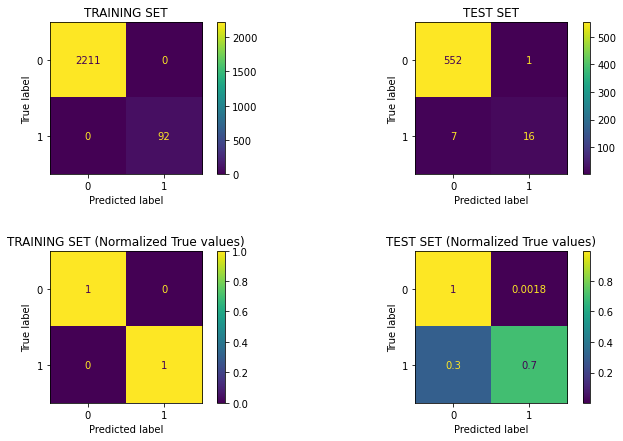

In [125]:
# Plot the confusion matrix for the training and test set
clf = rf_fit

fig = plt.figure(figsize=(12, 7))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')


ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.subplots_adjust(hspace=0.5)  # Ajuste espacio vertical entre filas

plt.show()

Mostramos las matrices de confusión en este caso, tiene más sentido fijarse en las matrices con los datos normalizados debido al desbalanceo de clases. En estas gráficas se puede ver como se están clasificando correctamente el 70% de los festivos en el conjunto de test (con los datos normalizados). 

A continuación, con el mejor modelo resultante del entrenamiento anterior, vamos a balancear las clases con el método smote y a reentrenar el Random Forest, en este caso sin optimización de hiperparámetros.

In [126]:
# Ahora probamos con SMOTE

smote = SMOTE(random_state = 11)
X_train_SMOTE, y_train_SMOTE = smote.fit_resample(X_train, y_train)

# Define pipeline with SMOTE to balance classes
pipe_balanced = imbalanced_make_pipeline(RandomForestClassifier(
                                            criterion='gini',  # impurity measure
                                            min_samples_split=6, # Minimum number of obs in node to keep cutting
                                            min_samples_leaf=1, # Minimum number of obs in a terminal node  
                                            max_features=22, # GS_CV - Number of features to consider when looking for the best split
                                            n_estimators=80, # GS_CV -  Number of trees in the forest
                                            random_state=0))

# Fit the balanced pipeline
pipe_balanced.fit(X_train_SMOTE[INPUTS_RF], y_train_SMOTE)

Pipeline(steps=[('randomforestclassifier',
                 RandomForestClassifier(max_features=22, min_samples_split=6,
                                        n_estimators=80, random_state=0))])

In [127]:
# Guardamos el modelo entrenado para agilizar la parte de validación
filename = "./models/random_forest_SMOTE.pickle"
# # save model
pickle.dump(pipe_balanced, open(filename, "wb"))

In [128]:
# model predictions in training (TR) and test (TS) sets
clf = pipe_balanced
y_train_pred = clf.predict(X_train_SMOTE[INPUTS_RF]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_RF]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train_SMOTE,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train_SMOTE,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train_SMOTE, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                         TR        TS
Accuracy           0.999774  0.979167
Balanced accuracy  0.999774  0.843305

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference    1    0
         1 2210    1
         0    0 2211

Accuracy: 1.0
No Information Rate: 0.5
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.5
Detection Rate: 0.5
Detection prevalence: 0.5
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  5 548

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.01
Kappa: 0.72
Mcnemar's Test P-Value: 0.77
Sensitivity: 0.99
Specificity: 0.7
Precision: 0.76
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.95
Detection prevalence: 0.96
Balanced accuracy: 0.84
F1 Score: 0.73
Positive label: 1


Haciendo un balanceo de clases, obtenemos las siguientes métricas:

**METRICAS EN TRAINING:**

Confusion Matrix and Statistics

|         | Prediction 1 | Prediction 0 |
|---------|-------------|--------------|
| Reference 1 | 2210        | 1          |
| Reference 0 | 0           | 2211       |

En esta matriz se puede ver que el modelo ha acertado en todos los casos positivos (2210) y en prácticamente todos los casos negativos (2211), lo que significa que no ha habido apenas errores. El modelo se ha aprendido los datos de entrenamiento perfectamente


| Metrics           | Value |
|---------------------|-------|
| Accuracy            | 1.0   |
| No Information Rate | 0.5   |
| P-Value [Acc > NIR]  | 0.0   |
| Sensitivity         | 1.0   |
| Specificity         | 1.0   |
| **Precision**           | 1.0   |
| Recall              | 1.0   |
| Detection Rate      | 0.5   |
| **Balanced accuracy**   | 1.0   |
| **F1 Score**            | 1.0   |
| Positive label      | 1     |

En el conjunto de entrenamiento (Training), todas las métricas son perfectas, lo que indica que el modelo ha aprendido bien las características de los datos y ha ajustado perfectamente a la muestra de entrenamiento. 

**METRICAS EN TEST**:

Confusion Matrix and Statistics
|         | Prediction 1 | Prediction 0 |
|---------|-------------|--------------|
| Reference 1 | 16        | 5          |
| Reference 0 | 7           | 548       |

En esta matriz de test también se puede observar que el modelo ha acertado en la mayoría de los casos. De los 21 casos positivos (referencia 1 = Festivos), solo ha fallado en 5, lo que significa que ha acertado en el 76,19% de las muestras de días festivos. De los 555 casos negativos (referencia 0), solo ha fallado en 7, lo que significa que ha acertado en el 98,74% de los casos.

| Matrics           | Value |
|---------------------|-------|
| Accuracy            | 0.98  |
| No Information Rate | 0.93  |
| P-Value [Acc > NIR]  | 0.01  |
| Sensitivity         | 0.99  |
| Specificity         | 0.7   |
| **Precision**           | 0.76  |
| Recall              | 0.7   |
| Detection Rate      | 0.95  |
| **Balanced accuracy**   | 0.84  |
| **F1 Score**            | 0.73  |
| Positive label      | 1     |

En el conjunto de prueba (Test), el modelo sigue teniendo un rendimiento bastante bueno, con una precisión del 0.98 y una sensibilidad del 0.99. Aunque la especificidad es más baja en el conjunto de prueba, todavía se considera aceptable en 0.7. El Balanced accuracy y el F1 score están por encima del 0.7, lo que indica un buen desempeño general del modelo.


Parece que el modelo ha mejorado al balancear los datos, ya que hemos conseguido un Balanced Accuracy en Test de 0.85 en comparación con el 0.84 que obtuvimos antes de balancear los datos. Además, podemos observar que la sensibilidad ha mejorado de 0.9 a 1.0, lo que indica que ahora el modelo está clasificando correctamente todas las muestras de la clase 1 (festivos).

Sin embargo, también podemos ver que la especificidad ha disminuido de 0.9 a 0.7 y que la precisión ha bajado de 1.0 a 0.94. Esto puede deberse a que al balancear los datos, estamos dando más importancia a la clase minoritaria (festivos), lo que hace que el modelo tenga una tendencia a clasificar más muestras como positivas de la clase 1, lo que aumenta los falsos positivos.


#### 1.5. Ajusta un gradient boosting para resolver el problema planteado.

- Optimiza la complejidad
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Revisa la importancia de las variables

A continuación se ha ajustado un modelo de Gradient Boosting para clasificar los días no festivos del dataset. En el código más adelante, tan solo se muestra el mejor modelo. Sin embargo, se probaron unos cuantos siguiendo la siguiente estrategia:

1. Primero se probó a realizar una optimización de los hiper-parámetros mediante el algoritmo de GridSearch, eligiendo el modelo con F1-score más alta. Los hiper-parámetros optimizados y los rangos utilizados fueron:

| Hiper parámetro   | Rango      | Valor óptimo |
|-------------------|------------|--------------|
| number_estimators | 100 - 500  | 300          |
| learning_rate     | 0.01 - 0.1 | 0.08         |
| max_depth         | 2-8        | 3            |
| max_features      | 3-6        | 5            |
| min_samples_split | 2-4        | 2            |
| min_samples_leaf  | 1-3        | 1            |

2. El modelo obtenido mediante GridSearch() presentaba un overfitting bastante alto, por lo que se decicidió simplificar el modelo mediante selección de variables y limitación del número de estimadores para que fuese capaz de generalizar mejor.

3. El modelo #2 obtenía un F1-score mejor que el #1. Sin embargo, el Recall era bastante bajo, por lo que se decidió utilizar una técnica de sobremuestreo llamada SMOTE para balancear el dataset.

4. El modelo de SMOTE es el que mejor generaliza obteniendo las mejores puntuaciones ante nuevas muestras.

A continuación se muestra el código empleado para el último modelo:

In [129]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

In [130]:
number_estimators = 100
learning_rate = 0.08
max_depth = 3
min_impurity_decrease =  0.001 * np.var(y_train)

smote = SMOTE(random_state = 11)
X_train, y_train = smote.fit_resample(X_train, y_train)

pipe = Pipeline(steps=[('scaler', StandardScaler()),
                       ('GB', GradientBoostingClassifier(n_estimators=number_estimators,
                                            learning_rate = learning_rate,
                                            max_depth = max_depth,
                                            max_features = 1.0, # 'auto', ‘sqrt’, ‘log2’, int or float, default=None
                                            loss = 'log_loss',   # binomial and multinomial deviance
                                            min_samples_split=2, # Minimum number of obs in node to keep cutting
                                            min_samples_leaf=1, # Minimum number of obs in a terminal node  
                                            random_state=0))]) # For replication

INPUTS_BT = INPUTS
nFolds = 10
pipe.fit(X_train[INPUTS_BT], y_train) # Search in grid

Pipeline(steps=[('scaler', StandardScaler()),
                ('GB',
                 GradientBoostingClassifier(learning_rate=0.08,
                                            max_features=1.0,
                                            random_state=0))])

In [131]:
# model predictions in training (TR) and test (TS) sets
clf = pipe
y_train_pred = clf.predict(X_train[INPUTS_BT]).tolist()
y_test_pred = clf.predict(X_test[INPUTS_BT]).tolist()

# main metrics
acc_tr = metrics.accuracy_score(y_train,y_train_pred)
acc_ts = metrics.accuracy_score(y_test,y_test_pred)

acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

                         TR        TS
Accuracy           0.995929  0.982639
Balanced accuracy  0.995929  0.845114

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference    1    0
         1 2198   13
         0    5 2206

Accuracy: 1.0
No Information Rate: 0.5
P-Value [Acc > NIR]: 0.0
Kappa: 0.99
Mcnemar's Test P-Value: 0.1
Sensitivity: 1.0
Specificity: 0.99
Precision: 1.0
Recall: 0.99
Prevalence: 0.5
Detection Rate: 0.5
Detection prevalence: 0.5
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  3 550

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.75
Mcnemar's Test P-Value: 0.34
Sensitivity: 0.99
Specificity: 0.7
Precision: 0.84
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.95
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.76
Positive label: 1


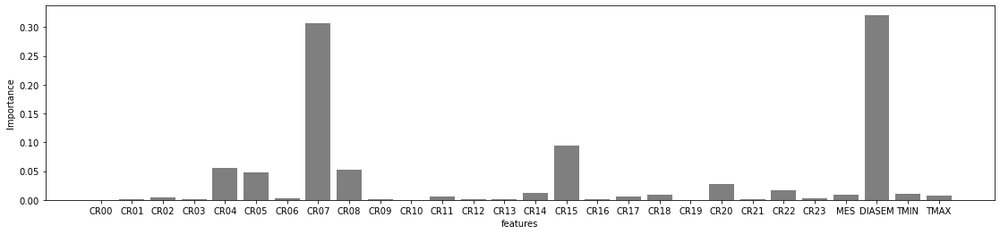

In [132]:
## Plot the variable importance of each feature
plt.figure(figsize=(19, 4))
bar_width = 0.35
plt.bar(INPUTS_BT, clf['GB'].feature_importances_, color='black', alpha=0.5)
plt.xlabel('features')
plt.ylabel('Importance')
plt.show()

En la celda anterior se muestra un gráfico de las variables más importantes para este modelo. Estas variables son:

1. Día de la semana
2. Consumo a las 07:00
3. Consumo a las 15:00
4. Consumo a las 04:00
5. Consumo a las 08:00
6. Consumo a las 05:00
7. Consumo a las 20:00

Las variables más importantes, son, por tanto, muy similares a las obtenidas en modelos anteriores. Esto es lógico ya que el modelo deberá primero comprobar si se trata de un día de diario o fin de semana (DIASEM), ya que los fines de semana se comportan de forma muy similar a los festivos. 

Una vez que se sabe que es entre semana, habrá mucha diferencia de consumo entre festivos y no festivos a las 7:00 y 8:00 de la mañana, cuando la gente se desprierta para ir a trabajar. Si es festivo la hora de despertarse se pospone. 

También habrá diferencia importante a las 15:00, ya que en España en un día festivo se hará a esta hora descanso para comer o para dormir la siesta, mientras que en un día de diario es necesario continuar trabajando.

Por último, un día festivo tendrá mayor actividad a las 04:00 y 05:00 de la mañana, ya que la gente saldrá de fiesta y continuará despierta hasta mucho más tarde.

A continuación se guarda el modelo para su uso más adelante.

In [133]:
filename = "./models/gradient_boosting.pickle"
pickle.dump(pipe, open(filename, "wb"))

#### 1.6. Utiliza staking con tus mejores tres modelos para intentar mejorar la soluciones obtenidas.
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación

In [134]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

Cargamos los modelos dentro de la carpeta **models**

In [135]:
loaded_btree = pickle.load(open("./models/bagged_tree_v2.pickle", "rb"))
loaded_rf = pickle.load(open("./models/random_forest_v2.pickle", "rb"))
loaded_gb = pickle.load(open("./models/gradient_boostingv2.pickle", "rb"))

Primero realizamos el stacking con los modelos base que hemos entrenado anteriormente sin SMOTE. Hemos asignado el peso en función del F1 score que hemos obtenido en el conjunto de test en los distintos modelos.

In [136]:
weights = [0.4, 0.1, 0.5]
stacked_reg = VotingClassifier(estimators = [('GB', loaded_gb), ('BT', loaded_btree), ('RF', loaded_rf)], weights = weights)
stacked_reg = stacked_reg.fit(X_train, y_train)
stacked_reg.get_params()

{'estimators': [('GB',
   GradientBoostingClassifier(learning_rate=1.0, max_depth=1, max_features=1.0,
                              n_estimators=5000, random_state=0)),
  ('BT',
   BaggingClassifier(base_estimator=Pipeline(steps=[('DT',
                                                     DecisionTreeClassifier(criterion='entropy',
                                                                            min_samples_leaf=3,
                                                                            min_samples_split=4,
                                                                            random_state=999))]),
                     n_estimators=50, random_state=0)),
  ('RF',
   RandomForestClassifier(class_weight='balanced', max_features=22,
                          min_samples_split=6, n_estimators=80, random_state=0))],
 'flatten_transform': True,
 'n_jobs': None,
 'verbose': False,
 'voting': 'hard',
 'weights': [0.4, 0.1, 0.5],
 'GB': GradientBoostingClassifier(learning_rat

Guardamos el modelo en la carpeta **models**

In [137]:
# save model
with open('./models/stacked_reg_model01.pickle', 'wb') as file:
    pickle.dump(stacked_reg, file)

Procedemos a ver la importancia de las variables para en cada modelo del stacking

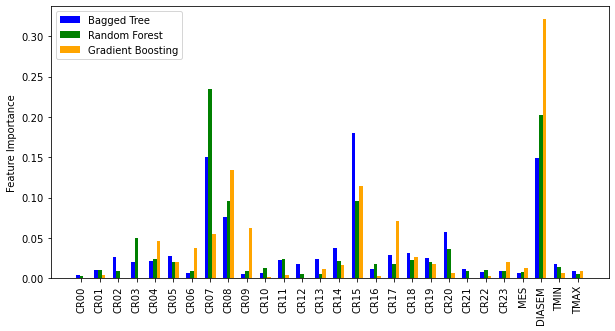

In [138]:
# Get feature importances for each model
btree_importances = [t['DT'].feature_importances_ for t in loaded_btree.estimators_]
rf_importances = loaded_rf.feature_importances_
gb_importances = loaded_gb.feature_importances_

# Calculate mean feature importances for bagged tree
bt_mean_importances = np.mean(btree_importances, axis=0)

# Create figure and axes
fig, ax = plt.subplots(figsize=(10, 5))

# Plot feature importances for each model
ax.bar(np.arange(len(INPUTS))-0.2, bt_mean_importances, width=0.2, label='Bagged Tree', color='blue')
ax.bar(np.arange(len(INPUTS)), rf_importances, width=0.2, label='Random Forest', color='green')
ax.bar(np.arange(len(INPUTS))+0.2, gb_importances, width=0.2, label='Gradient Boosting', color='orange')

# Add x-axis ticks and labels
ax.set_xticks(range(len(INPUTS)))
ax.set_xticklabels(INPUTS, rotation=90)

# Add y-axis label
ax.set_ylabel('Feature Importance')

# Add legend
ax.legend()

# Show plot
plt.show()


In [139]:
# estimations using the stacked models
y_train_stack = stacked_reg.predict(X_train)
y_test_stack = stacked_reg.predict(X_test)

# errors
acc_tr = metrics.accuracy_score(y_train_stack, y_train)
acc_ts = metrics.accuracy_score(y_test_stack, y_test)

acc_bal_tr = metrics.balanced_accuracy_score(y_train_stack, y_train)
acc_bal_ts = metrics.balanced_accuracy_score(y_test_stack, y_test)

dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc)

print(f'accuracy(TR, stack) = {acc_tr}')
print(f'accuracy(TS, stack) = {acc_ts}')
print(f'accuracy_balanced(TR, stack) = {acc_bal_tr}')
print(f'accuracy_balanced(TS, stack) = {acc_bal_ts}')

print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train, y_train_stack, labels=[1,0])

                    TR        TS
Accuracy           1.0  0.986111
Balanced accuracy  1.0  0.964327
accuracy(TR, stack) = 1.0
accuracy(TS, stack) = 0.9861111111111112
accuracy_balanced(TR, stack) = 1.0
accuracy_balanced(TS, stack) = 0.9643270546143323

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1    0
         1 92    0
         0  0 2211

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1


In [140]:
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test, y_test_stack, labels=[1,0])


METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 16   7
         0  1 552

Accuracy: 0.99
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.0
Kappa: 0.79
Mcnemar's Test P-Value: 0.07
Sensitivity: 1.0
Specificity: 0.7
Precision: 0.94
Recall: 0.7
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.85
F1 Score: 0.8
Positive label: 1


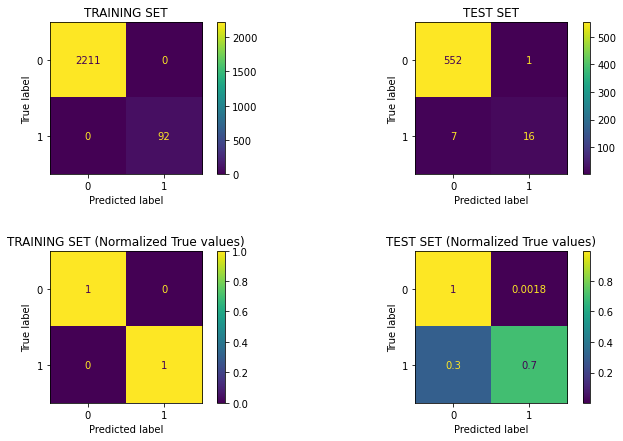

In [141]:
# Plot the confusion matrix for the training and test set
clf = stacked_reg

fig = plt.figure(figsize=(12, 7))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax)
plt.title ('TEST SET')


ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf, X_train, y_train, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf, X_test, y_test, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.subplots_adjust(hspace=0.5)  # Ajuste espacio vertical entre filas

plt.show()

Analisis de las métricas más relevantes obtenidas con **STACKING** para nuestro problema:

| Metrics              | TR        | TS        |
|----------------------|-----------|-----------|
| Accuracy             | 1.0       | 0.986111  |
| Balanced accuracy    | 1.0       | 0.964327  |

Obtenemos un Balanced Accuracy en Train de 1.0 y en test de 0.96, consideramos que es un resultado bastante bueno.

Métricas obtenidas con el conjunto de datos de entrenamiento:

**MÉTRICAS EN TRAINING:**

Confusion Matrix and Statistics

|         | Prediction 1 | Prediction 0 |
|---------|-------------|--------------|
| Reference 1 | 92        | 0          |
| Reference 0 | 0           | 2211         |

Nos da buenos resultados, teniendo 92 muestras de la clase 1 (True Positives - Festivos) clasificadas correctamente y 2211 muestras de la clase 0 (True Negatives - No festivos). Además, el modelo no cometió ningún error de clasificación para la clase 1 (festivos) ni para la clase 0 (falsos positivos). 

| Metrics              | Value    |
|----------------------|-----------|
| Accuracy             | 1.0       |
| No Information Rate  | 0.92       |
| P-Value [Acc > NIR]   | 0.0       |
| Sensitivity          | 1.0       |
| Specificity          | 1.0       |
| **Precision**            | 1.0       |
| Recall               | 1.0       |
| Detection Rate       | 0.5       |
| **Balanced accuracy**    | 1.0      |
| **F1 Score**             | 1.0      |
| Positive label       | 1         |

En general, el modelo parece tener un buen rendimiento en los datos de entrenamiento, con una alta tasa de precisión, sensibilidad y especificidad. Fijándonos en el F1 score, podemos ver que hemos obtenido un resultado de 0.95, lo cual es muy bueno teniendo en cuenta la naturaleza de nuestro conjunto de datos.

A continuación vamos a analizar las métricas obtenidas con el conjunto de datos de test:


**MÉTRICAS EN TEST:**

Confusion Matrix and Statistics

|         | Prediction 1 | Prediction 0 |
|---------|--------------|--------------|
| Reference 1 | 16           | 7            |
| Reference 0 | 1            | 552          |

Podemos observar que el modelo ha clasificado correctamente 16 muestras de la clase 1 (Festivos) y 552 muestras de la clase 0 (días laborables). Además, podemos ver que el modelo ha cometido 7 errores de clasificación en los festivos (clase 1) y 1 error de clasificación para los días laborables (clase 0). 

El rendimiento del modelo parece haber disminuido en los datos de prueba, ya que la sensibilidad y la precisión son más bajas y el número de falsos negativos es más alto. 


| Metrics              | Value    |
|----------------------|-----------|
| Accuracy             | 0.99      |
| No Information Rate  | 0.93      |
| P-Value [Acc > NIR]   | 0.0       |
| Sensitivity          | 1.0       |
| Specificity          | 0.7       |
| **Precision**            | 0.94      |
| Recall               | 0.7       |
| Detection Rate       | 0.96      |
| **Balanced accuracy**    | 0.85      |
| **F1 Score**             | 0.8       |
| Positive label       | 1         |

Por último, observando el balance accuracy y el F1 score del modelo con los datos de test, podemos ver que hemos obtenido un resultado más que aceptable, teniendo en cuenta la calidad de nuestros datos.

#### 1.7. Crea un número de variables reducido que contengan la información recogida en las variables CR00 a CR23 y crea un árbol sencillo basado en estas variables.
- El conjunto de variables creado tienen que ser una combinación lineal de CR00, ..., CR23
- Optimiza la complejidad del árbol
- Revisa los errores en TR y TS, la matrices de confusión, y verifica la capacidad de generación
- Analiza la lógica que emplea para determinar si es festivo
- Revisa la importancia de las variables, explicando el significado físico de las variables más importantes
- Compara los errores en TR y TS y la lógica del modelo con el creado anteriormente en el apartado 1.2.


**Creamos las PCAs**

En primer lugar vamos a crear un conjunto de variables combinadas (Z), que nos ayudarán a ver cual o cuales variables Z con las que más explican.

In [142]:
#Store in X variable clean data for PCA analysis
df_new = df_aju.drop('FECHA', axis=1)
X = df_new.drop('FESTIVO', axis=1) # sacamos los datos de los que quiero sacar las CP
y = df_new[['FESTIVO']]

In [143]:
# Preprocessing the values to perform PCA
numeric_features = X.select_dtypes(include=['int64','float64']).columns.values.tolist() 
scaler = StandardScaler() # transformamos las variables estandarizándolas
X_transformed = scaler.fit_transform(X=X)
X_transformed.shape

(2879, 28)

In [144]:
## PCA ----------------------------------------------------- Calculamos las CP
# generamos el modelo de PCA, queremos que nos calcule tantas componentes como 
# número de variables que tenemos de cara a elegir cuantas componentes es lo 
# óptimo
pca = PCA(n_components=X_transformed.shape[1],) 
X_pca = pca.fit_transform(X_transformed) # obtengo mis componentes reducidas
X_pca.shape

(2879, 28)

El siguiente código muestra una tabla que contiene información sobre la varianza explicada por cada componente principal en un análisis de componentes principales (PCA). La tabla tiene 2 columnas
- Exp_variance: muestra la fracción de la varianza total del conjunto de datos que se explica por cada componente principal.
- cum_Exp_variance: muestra la varianza acumulada explicada por todas las componentes principales hasta esa fila.

La elección de las 6 primeras componentes principales para aplicar en el modelo se basa en la observación de que el modelo empeora cuando se utilizan solo las 5 primeras componentes principales, que explican el 80% de la varianza total.

Esto sugiere que la información contenida en la sexta componente principal también es importante para el modelo. 

In [145]:
exp_variance = pd.DataFrame(data=pca.explained_variance_ratio_, index = ['PC' + str(n_pca + 1) for n_pca in range(pca.n_components)], columns=['Exp_variance'])
exp_variance['cum_Exp_variance'] = exp_variance['Exp_variance'].cumsum()
exp_variance.head(8)

,Exp_variance,cum_Exp_variance
PC1,0.356050,0.356050
PC2,0.198940,0.554990
PC3,0.132584,0.687574
PC4,0.087937,0.775511
PC5,0.063644,0.839156
PC6,0.035793,0.874948
PC7,0.021991,0.896939
PC8,0.021909,0.918849


In [146]:
# Ajustar el modelo PCA a los datos
pca.fit(X)

# Obtener las primeras 5 componentes principales
X_pca = pca.transform(X)[:, :6]

df_pca = pd.DataFrame(X_pca)
print(df_pca.shape)
df_pca.head()

(2879, 6)


,0,1,2,3,4,5
0,-9.295340,1.525765,1.018383,0.113731,0.005991,0.019091
1,-9.539581,1.407460,0.026839,0.321461,-0.005480,0.007157
2,-8.238733,2.011149,-0.998969,-0.054135,-0.006231,0.005814
3,-5.915905,3.236940,-2.009938,0.474884,-0.005483,0.005426
4,-7.045003,2.769405,-2.965235,1.590213,-0.002862,0.006228


**Optimizamos la complejidad del modelo**

En el siguiente código estamos realizando una búsqueda de los mejores parámetros para un modelo de árbol de decisión utilizando Grid Search Cross Validation.

Además, hemos decidido utilizar SMOTE que es una técnica de sobremuestreo para crear un conjunto de datos de entrenamiento equilibrado en términos de clases.

In [147]:
# set the ramdom seed for reproductivility
np.random.seed(999)

# Crea dos dataframes df_aju_tr y df_aju_ts y trabaja con ellos
OUTPUT = 'FESTIVO'
INPUTS_PCA = df_pca.columns
X = df_pca[INPUTS_PCA]
y = df_aju[OUTPUT]

# Split
X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(X, y,
                                                    test_size=0.2,  #percentage of test data
                                                    random_state=0, #seed for replication
                                                    stratify = y)   #Preserves distribution of y

In [148]:
smote = SMOTE(random_state = 11)
X_train_SMOTE, y_train_SMOTE = smote.fit_resample(X_train_pca, y_train_pca)

In [149]:
# grid in min_impurity x min_samples_leaf x min_samples_split - crea una lista de diccionarios
param = {'DT__min_impurity_decrease': np.arange(0,0.05,0.005), # Minimum entropy to decrease in each split
         'DT__min_samples_leaf': np.arange(1,10,1), # Minimum number of obs in a terminal node
         'DT__min_samples_split':  np.arange(1,10,1)} # Minimum number of obs in node to keep cutting (entropía tiene que ir disminuyendo, pero llegado a un punto la disminucion es insignificante)
                                                      # La entropia mide el desorden, buscamos que los nodos terminales sean lo mas puro posible, pero sin pasarme, es decir, que no tengan desorden
                                                      # para conseguirlo, el arbol corta el espacio de entrada para conseguir cada vez regiones más limpias, para llegar a tener en los nodos terminales la entropia mas minima
        
pipe = Pipeline(steps=[('DT', DecisionTreeClassifier(criterion='gini',  # impurity measure
                                                     random_state=150))]) # For replication
                                                     
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
# GridSearchCV -> busca la mejor combinación de hiperparámetros
tree_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='accuracy', # Accuracy https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
tree_fit.fit(X_train_SMOTE[INPUTS_PCA], y_train_SMOTE) # Search in grid

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('DT',
                                        DecisionTreeClassifier(random_state=150))]),
             n_jobs=-1,
             param_grid={'DT__min_impurity_decrease': array([0.   , 0.005, 0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 ,
       0.045]),
                         'DT__min_samples_leaf': array([1, 2, 3, 4, 5, 6, 7, 8, 9]),
                         'DT__min_samples_split': array([1, 2, 3, 4, 5, 6, 7, 8, 9])},
             scoring='accuracy')

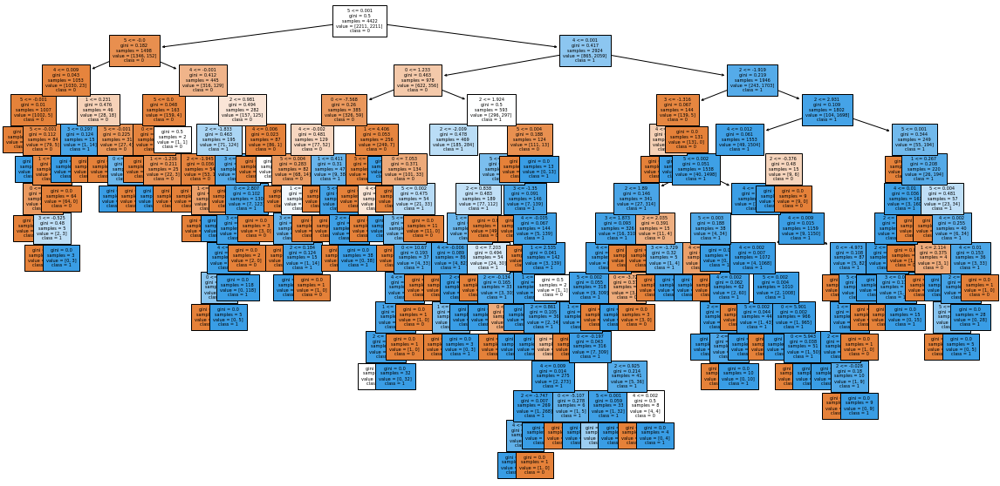

In [150]:
## Plot the decision tree model (use figsize and fontsize for getting the best view)
plt.figure(figsize=(20, 10))
plot_tree(tree_fit.best_estimator_['DT'], # Utiliza los parámetros óptimos obtenidos de la búsqueda de la cuadrícula
          feature_names= INPUTS_PCA, # Lista de variables utilizadas en el modelo
          class_names= [str(s) for s in y_train_SMOTE.unique()], # Lista de nombres de las clases objetivo en el modelo
          fontsize=5, # Tamaño de fuente utilizado en la visualización del árbol
          filled=True) # Las cajas del árbol se colorearán según la mayoría de la clase objetivo
plt.show()

**Revisamos los errores en TR y TS**

- **F1 score**

En este modelo el F1 score en train es de 1, es decir, ha logrado una precisión perfecta en el conjunto de datos de entrenamiento. Esto nos sugiere que el modelo ha memorizado el conjunto de entrenamiento en lugar de aprender patrones generales. En cuanto a la parte de test, ha obtenido un F1 score de 0.61, lo que nos indica que este modelo tiene un rendimiento limitado en nuevos datos, además de ser un indicio de overfitting debido a la diferencia en train y test.


- **Balanced accuracy**

Analizaremos el Balanced accuracy al igual que en modelos anteriores. En train hemos obtenido un balanced accuracy de 0.998643 y en test de 0.875029, que nos indica un alto rendimiento del modelo en la discriminación entre las clases. Sin embargo, necesitamos una evaluación más detallada para determinar si el modelo esta sobreajustado a los datos de entrenamiento.


- **Precision**

Hemos obtenido una precision de 1.0 en el conjunto de entrenamiento, que nos indica que todas las muestras positivas en train han sido clasificadas correctamente por el modelo (puede que haya memorizado el conjunto de datos de train). Por otra parte, una precisión del 0.5 en test nos dice que el modelo ha clasificado correctamente el 50% de las muestras positivas en test, es decir, el modelo no esta generalizando correctamente. Estos valores en la precisión, nos indica que el modelo tiene overfitting.

- **Recall**

Un Recall de 1.0 en train nos indiac que todas las muesrtas positicas en train se clasificaron correctamente, pero al igual que ya he explicado, nos indica que el modelo esta memorizando los patrones de las muestras positivas. Esto se ve reflejado en el 0.78 que hemos obtenido en test, que al haber tanta diferencia nos indica que el modelo no generaliza correctamente.


En **resumen**, podemos obseravr que las diferencias entre el rendimiento en el conjunto de train y de test nos indican que el modelo esta sobreajustando los datos de entrenamiento, provocando overfitting.

In [151]:
clf_pca = tree_fit.best_estimator_['DT']
y_train_pred_pca = clf_pca.predict(X_train_SMOTE[INPUTS_PCA]).tolist()
y_test_pred_pca = clf_pca.predict(X_test_pca[INPUTS_PCA]).tolist()

# main metrics
# Se calcula la precisión y la precisión equilibrada
acc_tr_pca = metrics.accuracy_score(y_train_SMOTE,y_train_pred_pca)
acc_ts_pca = metrics.accuracy_score(y_test_pca,y_test_pred_pca)

acc_bal_tr_pca = metrics.balanced_accuracy_score(y_train_SMOTE,y_train_pred_pca)
acc_bal_ts_pca = metrics.balanced_accuracy_score(y_test_pca,y_test_pred_pca)

dfacc_pca =  pd.DataFrame([[acc_tr_pca, acc_ts_pca], [acc_bal_tr_pca, acc_bal_ts_pca]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
print(dfacc_pca)

# Se crean las confusion matrixs
print('\nMETRICS TRAINING:')
CT.confusion_matrix(y_train_SMOTE, y_train_pred_pca, labels=[1, 0])
print('\nMETRICS TEST SET:')
CT.confusion_matrix(y_test_pca, y_test_pred_pca, labels=[1, 0])

                         TR        TS
Accuracy           0.998643  0.960069
Balanced accuracy  0.998643  0.875029

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference    1    0
         1 2206    5
         0    1 2210

Accuracy: 1.0
No Information Rate: 0.5
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 0.22
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.5
Detection Rate: 0.5
Detection prevalence: 0.5
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 18   5
         0 18 535

Accuracy: 0.96
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.56
Kappa: 0.59
Mcnemar's Test P-Value: 0.01
Sensitivity: 0.97
Specificity: 0.78
Precision: 0.5
Recall: 0.78
Prevalence: 0.96
Detection Rate: 0.93
Detection prevalence: 0.94
Balanced accuracy: 0.88
F1 Score: 0.61
Positive label: 1


**Matriz de confusión**

Teniendo en cuenta que una matriz de confusión ideal tendría valores de TP y TN altos, y valores de FP y FN bajos, en este caso en el conjunto de train aunque los valores de FN y FP son bajos, su presencia indica que el modelo aún tiene margen de mejora en la clasificacion de muestras positivas y negativas.

Por otra parte en la matriz de confusión de test podemos ver que ha clasificado correctamente el 97% de TP, pero solo el 78% de TN. La diferencia de estos valores con la matriz de confusión de train nos indica que el modelo tiende a tener overfitting, como ya hemos mencionado previamente.

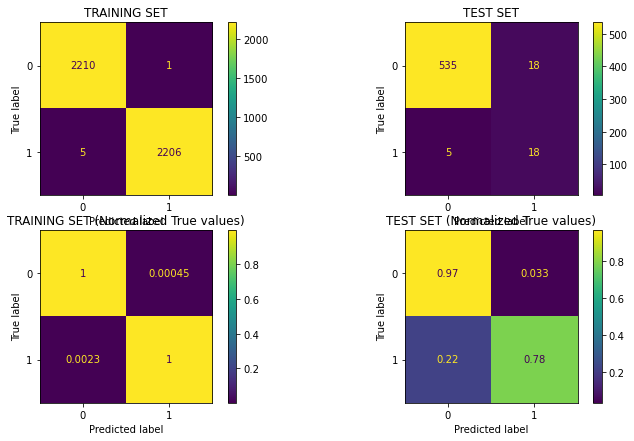

In [152]:
fig = plt.figure(figsize=(12, 7))

ax = plt.subplot(2,2,1)
ConfusionMatrixDisplay.from_estimator(clf_pca, X_train_SMOTE, y_train_SMOTE, ax = ax)
plt.title ('TRAINING SET')

ax = plt.subplot(2,2,2)
ConfusionMatrixDisplay.from_estimator(clf_pca, X_test_pca, y_test_pca, ax = ax)
plt.title ('TEST SET')

ax = plt.subplot(2,2,3)
ConfusionMatrixDisplay.from_estimator(clf_pca, X_train_SMOTE, y_train_SMOTE, ax = ax, normalize = 'true')
plt.title ('TRAINING SET (Normalized True values)')

ax = plt.subplot(2,2,4)
ConfusionMatrixDisplay.from_estimator(clf_pca, X_test_pca, y_test_pca, ax = ax, normalize = 'true')
plt.title ('TEST SET (Normalized True values)')

plt.show()

**Analizamos la lógica que emplea para determinar si es festivo**

Un árbol de clasificación simple para determinar si un día es festivo o no se basa en las características de ese día. Estas reglas se construyen mediante la evaluación de diferentes características y tomando decisiones de acuerdo a las mismas.

Por ejemplo, se puede evaluar que día de la semana es, o que mes, o que temperatura mínima y máxima ha hecho. En función de esta información se construyen unas reglas para determinar si es festivo o no.

**Revisamos la importancia de las variables, explicando el significado físico de las variables más importantes**

En los siguientes gráficos podemos ver la importancia de cada variable en las tres primeras componentes principales. Caad gráfico de barras muestra la importancia relativa de cada variable en una componente principal determinada. La altura de las barras muestra la importancia relativa, es decir, cuanto más altas son las barras, mayor influencia tendrá en esa PC.

Podemos ver que las variables a las que se les da importancia en las 3 primeras componentes principales son MES, DIASEM, TMIN y TMAX, variando su importancia en cada PC.

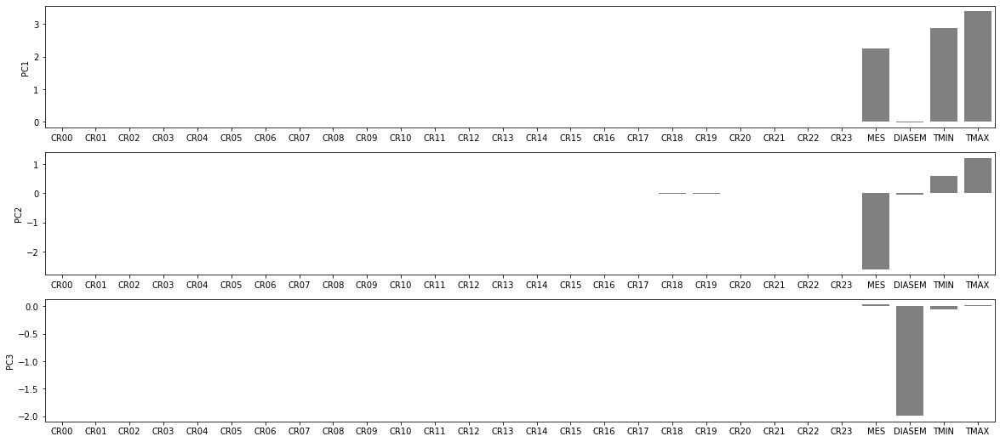

In [153]:
# Plot the 3 first PCs
# fig, axes = plt.subplots(loadings.shape[1], 1, figsize=(16,9))
loadings = pd.DataFrame(pca.components_.T * np.sqrt(pca.explained_variance_), columns=['PC' + str(pca + 1) for pca in range(pca.n_components)], index=numeric_features)
fig, axes = plt.subplots(3, 1, figsize=(20,9))
PC = 0
for ax in axes.ravel():
    sns.barplot(data=loadings, x=loadings.index, y=loadings.columns.values.tolist()[PC], color='gray', ax=ax)
    PC += 1

**Guardamos el modelo de las PCAs**

In [154]:
filename = "./models/pca.pickle"
pickle.dump(clf_pca, open(filename, "wb"))

#### 1.8 Compara todos los modelos creados en términos de complejidad, interpretabilidad y errores
- Discute el posible impacto que tiene en los modelos el que existan menos festivos que laborables
- Compara la complejidad en términos de nº de parámetros y estructura del modelo, variables utilizadas, importancia de las mismas
- Compara la capacidad de generalización de los modelos utilizando TS y las diferencias en las matrices de confusión
- Estudia la tasa de fallos de los modelos dependiendo del día de la semana
- Indica qué modelo o modelos son los más prometedores para poner en producción, justificando la selección

##### Desbalanceo
Cuando hablamos de datos desbalanceados, nos referimos a conjuntos de datos donde **una o varias clases tienen una cantidad significativamente menor de ejemplos que otras clases**. La representación en el dataset de días festivos es inferior al 4%, por lo que está **moderadamente desbalanceado (1-20%)** [1]. Esto causa que los modelos presenten una tendencia a clasificar todas las muestras como "no festivas", ya que de esta manera alcanzan una accuracy de aproximadamente 96%. Por lo tanto, es de extrema importancia **no utilizar la medida de accuracy** para evaluar los modelos. 

Para ello, destacan dos medidas: la **"balanced accuracy" y el "F1-score"**. La primera es una medida que tiene en cuenta el desbalanceo en las clases y es la media aritmética de las tasas de verdaderos positivos (TPR) y verdaderos negativos (TNR). La **Balanced Accuracy es adecuada cuando ambas clases tienen una importancia similar**, y cuando el objetivo es tener una tasa de clasificación correcta equilibrada entre ambas clases. Por otro lado, el F1-score combina tanto la precisión como el recall del modelo. Es adecuada cuando se desea equilibrar la importancia de la precisión y el recall. Esta medida es particularmente útil cuando el objetivo es **detectar correctamente los casos positivos** (la clase minoritaria en situaciones de desbalanceo), pero a costa de un mayor número de falsos positivos.

Para este trabajo, se ha elegido utilizar el **F1-score** ya que se ha considerado más útil identificar más días festivos, a costa de clasificar erróneamente un mayor número de "no festivos". Sin embargo, la balanced accuracy también podría ser una elección adecuada si para la aplicación fuese perjudicial obtener un número alto de falsos positivos. Por tanto, al tunear los hiperparámetros de los modelos, se han **elegido aquellos con un mayor F1-score**. Además, a la hora de evaluarlos, se compararán utilizando esta métrica. Por último, también se analizaran las puntuaciones de las medidad se Precision y Recall con el fin de entender en qué tipo de muestras se producen los fallos de los modelos.

Sin embargo, utilizar estas métricas puede no ser suficiente para obtener un buen resultado ya que al haber tan poca representación de la clase "Festivo", **es posible que no haya suficente información para que los modelos la aprendan**. Para compensarlo, se pueden utilizar técnicas de balanceo. En este contexto, el submuestreo y el sobremuestreo son técnicas utilizadas para abordar el desbalanceo en los datos.

El **submuestreo implica eliminar ejemplos de la clase mayoritaria** para equilibrar la distribución de clases. Sin embargo, esto puede llevar a la pérdida de información y disminuir la capacidad de generalización del modelo.

El **sobremuestreo, por otro lado, consiste en generar nuevos ejemplos de la clase minoritaria** para igualar su cantidad con la clase mayoritaria. Esta técnica puede aumentar el tamaño del conjunto de datos y permitir que el modelo aprenda más sobre la clase minoritaria, mejorando así la capacidad de generalización. Sin embargo, si se realiza de forma indiscriminada, puede llevar a la sobrecarga de información y al sobreajuste del modelo.

**SMOTE (Synthetic Minority Over-sampling Technique)** es una técnica de sobre-muestreo para conjuntos de datos desbalanceados. Esta técnica **genera nuevos datos sintéticos** de la clase minoritaria (la clase con menos ejemplos) mediante la **interpolación entre las instancias existentes**. Para ello, SMOTE selecciona aleatoriamente una instancia de la clase minoritaria y calcula los k vecinos más cercanos de esta instancia. A continuación, SMOTE elige aleatoriamente uno de estos vecinos y genera un nuevo punto sintético a lo largo del segmento que une la instancia seleccionada con su vecino seleccionado. Repitiendo este proceso para varias instancias de la clase minoritaria, SMOTE crea una nueva base de datos sintética que tiene un equilibrio más equitativo entre las clases. Esta técnica ha demostrado ser efectiva para mejorar el rendimiento de los algoritmos de aprendizaje automático en problemas de clasificación desbalanceados.

En este proyecto se ha utilizado la técnica de SMOTE en algunos algoritmos para mejorar su rendimiento. Es importante tener en cuenta que la técnica **se debe aplicar tan solo al conjunto de training**, nunca al de test o al de validación, ya que de hacerlo la evaluación se estaría realizando sobre un conjunto de datos sintético, que podría no ser representativo de la realidad.

##### Complejidad

Es importante conocer la complejidad de un modelo ya que esto puede afectar su **rendimiento y su capacidad para generalizar** correctamente. La complejidad puede medirse en términos de la complejidad temporal y espacial, así como la interpretabilidad del modelo.

- **Complejidad Espacial**: La complejidad espacial se refiere al espacio de memoria requerido para almacenar el modelo. Un modelo complejo puede requerir una gran cantidad de memoria, lo que puede ser un problema en sistemas con limitaciones de recursos. Por lo tanto, es importante evaluar la complejidad espacial junto con la complejidad temporal para garantizar que el modelo sea viable en términos de recursos. En este tipo de complejidad es clave el número de parámetros, el cual afecta de forma proporcional.

- **Complejidad Temporal**: La complejidad temporal se refiere al tiempo necesario para entrenar el modelo y hacer predicciones. Si un modelo es demasiado complejo, puede llevar mucho tiempo entrenar y predecir, lo que puede ser impráctico en situaciones donde se requiere una respuesta en tiempo real. Por lo tanto, es importante equilibrar la complejidad con la eficiencia temporal del modelo.

- **Interpretabilidad**: la interpretabilidad del modelo se refiere a la capacidad de entender cómo el modelo toma decisiones. Un modelo complejo puede ser difícil de interpretar, lo que puede ser un problema en situaciones donde es importante comprender la lógica detrás de las decisiones del modelo, como puede ser por ejemplo el ámbito médico. Por lo tanto, es importante evaluar la complejidad del modelo en términos de su interpretabilidad para garantizar que se pueda explicar adecuadamente cómo se tomaron las decisiones. En resumen, conocer la complejidad de un modelo es fundamental para garantizar su eficacia, eficiencia y comprensibilidad. A la hora de medir la interpretabilidad, es primordial tener en cuenta la estructura del modelo, las variables utilizadas y la importancia de las mismas.

Para calcular la complejidad espacial y la temporal, se han utilizado fórmulas aplicadas a cada algoritmo [2] [3], las cuales tienen en cuenta los siguientes parámetros:

- N = número de muestras
- d =dimensiones
- c = número de clases
- n = número de nodos
- k = número de árboles
- p = número de componentes principales

| Modelo                | Compl. Tiempo             | Compl. Espacio          | Interpretabilidad |
|-----------------------|---------------------------|-------------------------|-------------------|
| **Simple Tree**       | O(log(N))                 |  O(n)                   |  Alta             |
| **Bagged Tree**       | O(k log(N) )              |  O(n k)                 |  Baja             |
| **Random Forest**     | O(k log(N) )              |  O(n k)                 |  Baja             |
| **Gradient Boosting** | O(k log(N) )              |  O(n k)                 |  Baja             |
| **Stacking**          | O((k1 + k2 + k3) 3log(N)) |  O (k1n1 + k2n2 + k3n3) |  Muy Baja         |
| **PCA + Simple Tree** | O((N+1) d p)              |  O(N + d p)             |  Media            |

Para un mismo número de muestras y de nodos por árbol, el modelo de Simple Tree es el modelo más sencillo tanto en tiempo como en espacio. Además, es el más interpretable ya que se puede observar con claridad el flujo de toma de decisiones que lleva a acabo para la clasificación. Será, por tanto, el más sencillo de explicar a una persona no experta en machine learning.

##### Capacidad de Generalización
La capcidad de generalización de un modelo se define como su habilidad para trabajar con muestras nunca vistas, es decir, muestras que no se han utilizado para su entrenamiento. Para comparar la capacidad de generalización de los distintos modelos, se analizan las diferencias entre el las métricas en training y test de los distintos modelos, especialmente el la Balanced Accuracy y el F1-score. Se utiliza esta medida en lugar de la accuracy ya que, como se mencionó antes, debido al desbalanceo entre clases del dataset, esta medida no refleja correctamente la eficacia del modelo. Además, se usan la Precision y el Recall en test, como forma sencilla de comparar sus respectivas matrices de confusión.

Una puntuación alta en training pero relativamente baja en test significa que el modelo ha sobreaprendido las muestras de entrenamiento, y no es lo suficiciente general como para predecir correctamente el conjunto de test.

La tabla a continuación muestra las diferentes métricas obtenidas por los mejores modelos de cada tipo. 

| Modelo                | Acc TR | Acc TS | Bal Acc TR | Bal Acc TS | F1 TR | F1 TS | Precision TS | Recall TS | Underfitting | Overfitting*|
|-----------------------|--------|--------|------------|------------|-------|-------|--------------|-----------|--------------|-------------|
| **Simple Tree**       | 96.01% | 96.01% | 50%        | 50%        | 0     | 0     | 0%           | 0%        | High         | -           |
| **Bagged Tree**       | 100%   | 99%    | 94.57%     | 84.69%     | 0.94  | 0.80  | 94%          | 70%       | -            | Moderate    |
| **Random Forest**     | 99.97% | 97.91% | 99.97%     | 84.33%     | 1     | 0.73  | 76%          | 70%       | -            | High        |
| **Gradient Boosting** | 100%   | 98.26% | 100%       | 84.51%     | 1     | 0.76  | 84%          | 70%       | -            | High        |
| **Stacking**          | 100%   | 98%    | 99%        | 78%        | 0.99  | 0.7   | 93%          | 57%       | -            | High        |
| **PCA + Simple Tree** | 99.60% | 96.70% | 95.10%     | 77.04%     | 0.95  | 0.58  | 59%          | 57%       | -            | High        |

**The overfitting was meassured according to the TR and TS F1-score difference and the scale used was: {Low: < 0.1, Moderate: >0.1 and <0.2, High: >0.2}*

En términos de F1 en test, el mejor modelo es el Bagged tree, el cual alcanza el una puntuación de 0.8. Según el criterio elegido, es el mejor modelo.

Además, el Bagged Tree es el modelo que mejor capacidad de generalización presenta, al ser en el que existen menos diferencias entre las métricas de training y de test (exceptuando al Simple Tree, pero este modelo presenta mucho bias), con una diferencia de 9.88 pp en Balanced Accuracy y de 0.14 en F1-score. Este modelo se consiguió reducir el error en test mediante la reducción de complejidad del modelo, lo cual evitaba que se sobreajustase.

Para analizar las diferencias en las matrices de confusión, se han añadido en la tabla las métricas de Precision y Recall. Las conclusiones son las siguientes:
- En el Simple Tree, se ve claramente cómo el modelo, al predecir todo como "No festivo", no es capaz de encontrar ninguna muestra positiva (Precision y Recall = 0%)
- El Bagged Tree acierta al 94% las muestras que clasifica "Festivos", pero no encuentra los encuentra todos (encuentra un 65%). Esto porbablemente suceda por el desbalanceo de clases, porque para obtener una mayor precisión en test al modelo "le interesa" clasificar todo como "No festivo".
- El modelo de Random Forest acierta un 88% de las muestras que clasifica como "Festivas" (Precision = 88%), pero tan solo encuentra un 65% de los festivos (Recall = 65%).
- La situación con el Gradient Boosting es similar al Bagged Tree, si bien la puntuación es ligeramente más baja en Recall (65%).
- El modelo de staking obtiene una puntuación alta en Precision (93%), pero baja en Recall (57%).

##### Tasa de fallos según el día de la semana

En primer lugar se realiza un análisis exploratorio de los diferentes días de la semana, calculando en primer lugar el porcentaje de ocurrencias de cada día en el training set y después el porcentaje de festivos para cada día.

In [155]:
df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

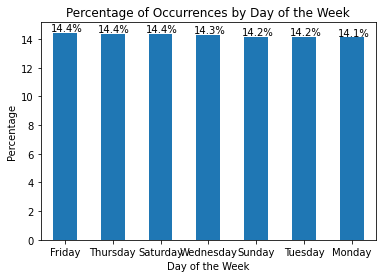

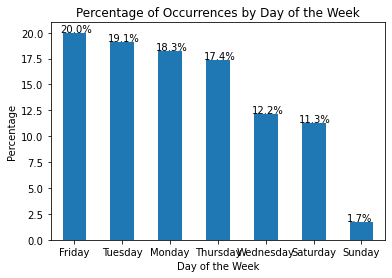

In [156]:
# create a dictionary to map numeric values to day names
day_names = {1: 'Monday', 2: 'Tuesday', 3: 'Wednesday', 4: 'Thursday', 5: 'Friday', 6: 'Saturday', 7: 'Sunday'}

# create a new column with day names
df_aju['DAY_NAME'] = df_aju['DIASEM'].map(day_names)

# count the occurrences of each day name
counts = df_aju['DAY_NAME'].value_counts()

# calculate the percentage of occurrences of each day name
percentages = (counts / counts.sum()) * 100

# create a bar plot of the percentages
ax = percentages.plot(kind='bar', width=0.5)

# set the plot title and axis labels
plt.title('Percentage of Occurrences by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Percentage')

# set the rotation of the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

for i, v in enumerate(percentages):
    ax.text(i-0.3, v+0.1, "{:.1f}%".format(v), color='black')

# show the plot
plt.show()

df_f = df_aju[(df_aju.FESTIVO == 1)]

# create a dictionary to map numeric values to day names
day_names = {1: 'Monday', 2: 'Tuesday', 3: 'Wednesday', 4: 'Thursday', 5: 'Friday', 6: 'Saturday', 7: 'Sunday'}

# create a new column with day names
df_f['DAY_NAME'] = df_f['DIASEM'].map(day_names)

# count the occurrences of each day name
counts = df_f['DAY_NAME'].value_counts()

# calculate the percentage of occurrences of each day name
percentages = (counts / counts.sum()) * 100

# create a bar plot of the percentages
ax = percentages.plot(kind='bar', width=0.5)

# set the plot title and axis labels
plt.title('Percentage of Occurrences by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Percentage')

# set the rotation of the x-axis tick labels
ax.set_xticklabels(ax.get_xticklabels(), rotation=0)

for i, v in enumerate(percentages):
    ax.text(i-0.3, v+0.1, "{:.1f}%".format(v), color='black')

# show the plot
plt.show()

Existe una representación muy parecida de todos los días de la semana en el dataset. Sin embargo, los días festivos no están representados de forma equitativa a lo largo de los días. Muy pocos días festivos suceden el miércoles, sábado o domingo. Esta falta de representación puede causar fallos a la hora de clasificar estos días. 

Para calcular la tasa de fallos según el día de la semana, ejecutamos el siguiente código:

En la tabla a continuación se comparan las métricas obtenidas para cada día de la semana:
| Día                   | Acc TR | Acc TS | Bal Acc TR | Bal Acc TS | F1 TR | F1 TS | Precision TS | Recall TS |
|-----------------------|--------|--------|------------|------------|-------|-------|--------------|-----------|
| **Lunes**             | 89.25% | 98.91% | 91.41%     | 99.43%     | 0.91  | 0.91  | 83%          | 100%      |
| **Martes**            | 93.62% | 98.43% | 93.62%     | 84.60%     | 0.93  | 0.78  | 89%          | 70%       |
| **Miércoles**         | 93.62% | 98.43% | 96.73%     | 82.42%     | 0.97  | 0.75  | 88%          | 65%       |
| **Jueves**            | 97.28% | 98.44% | 97.28%     | 82.51%     | 0.97  | 0.77  | 94%          | 65%       |
| **Viernes**           | 89.81% | 98.80% | 90.06%     | 90.00%     | 0.90  | 0.89  | 100%         | 80%       |
| **Sábado**            | 91.34% | 94.56% | 64.77%     | 50.00%     | 0.46  | 0.00  | 0%           | 0%        |
| **Domingo**           | 100%   | 97.50% | 100%       | 49.36%     | 1.00  | 0.00  | 0%           | 0%        |

Como se puede observar, el modelo en general acierta los festivos entre semana, mientras que no es capaz de identificar aquellos en fin de semana. Esto es lógico por dos razones:
- Como se vio en la gráfica anterior, el número de días destivos que caen en fin de semana es muy bajo, por lo que puede faltar información sobre cómo clasificarlos correctamente.
- El comportamiento de la población es muy similar un fin de semana que un día entre semana. 

Dependiendo de la aplicación, podría interesar no incluir los días de fin de semana en el dataset, ya que se puede asumir que son festivos y probablemente reduciría el ruido de los datos, mejorando los modelos.

**Modelo de producción**

El modelo a elegir para producción depende en gran medida de la aplicación. Lo más importante es que generalice correctamente para que sea capaz de adaptarse a nuevas muestras. Sin embargo, dependiendo de el uso que se vaya a hacer del modelo, puede ser más importante que clasifique correctamente una clase u otra. Entre los diferentes objetivos que pueden existir están acertar el mayor número de veces posible, encontrar todos los días festivos o que todos los días que se clasifiquen como festivos estén correctamente clasificados. Además, según el uso, se puede priorizar un modelo interpretable porque se necesite conocer la lógica detrás de la toma de decisiones.

Aunque no se especifica ninguna aplicación en específico para este proyecto, se puede asumir que el objetivo es entender cómo varía el uso de la electricidad según si el día es festivo o no. La lógica detrás de esta asumpción es que con tan solo mirar un calendario, se puede saber qué día es festivo con mayor precisión de la que va aportar un modelo. Sin embargo, A una compañía eléctrica le puede interesar conocer las diferencias en el consumo de energía en días festivos y no festivos por varias razones:

En primer lugar, el conocimiento de las diferencias en el consumo de energía durante días festivos y no festivos puede ayudar a la compañía a planificar la generación y distribución de energía de manera más efectiva. Por ejemplo, si se espera que el consumo de energía sea menor en días festivos, la compañía puede reducir la producción de energía y ajustar la distribución en consecuencia para evitar el desperdicio de recursos.

En segundo lugar, el conocimiento de las diferencias en el consumo de energía en días festivos y no festivos puede ayudar a la compañía a ajustar sus precios y tarifas para garantizar la rentabilidad y la eficiencia en la producción de energía. Si se espera que el consumo de energía sea menor en días festivos, la compañía puede reducir los precios para atraer a más consumidores y mantener la demanda de energía.

En tercer lugar, el conocimiento de las diferencias en el consumo de energía en días festivos y no festivos puede ayudar a la compañía a optimizar el uso de sus recursos, lo que puede ser beneficioso tanto desde una perspectiva económica como medioambiental. Si se espera que el consumo de energía sea menor en días festivos, la compañía puede programar el mantenimiento y la reparación de equipos y maquinarias para evitar interrupciones en la producción de energía en días de alta demanda.

En conclusión, conocer las diferencias en el consumo de energía en días festivos y no festivos puede proporcionar a una compañía eléctrica información valiosa para planificar, ajustar los precios y tarifas, optimizar el uso de los recursos y mejorar su eficiencia y rentabilidad en la producción y distribución de energía, por lo que la interpretabilidad del modelo será un factor clave a tener en cuenta a la hora de elegir cuál poner en producción.

Puesto que en los diferentes modelos se ha observado cómo las variables más importantes coincidían y era sencilllo entender por qué resultaban esas, se puede escoger casi cualquier modelo siguiendo el criterio de la interpretabilidad (aunque el Simple Tree aporta más información que la importancia de cada variable). Por lo tanto, se elegirá el modelo con mejores métricas.

La elección resulta sencilla porque el modelo de Bagged Trees destaca en todas las métricas. En primer lugar, es el modelo con menor diferencia entre los errores en training y en test, tanto en Accuracy (diferencia de 1 pp) como en Balanced Accuracy (diferencia de 9.88 pp) y F1-score (diferencia de 0.14). Además, es el modelo con mejores puntuaciones en test (Accuracy 99%, Balanced Accuracy 84.68% y F1-score 0.8). Tan solo se elegiría el Simple Tree si por límites de tiempo o espacio se necesitase un modelo más sencillo.

Por lo tanto, el modelo que se elegiría para llevar a producción sería el Bagged Tree.

---
### 2. VALIDACIÓN FINAL DE LOS MODELOS CON EL DATASET VAL_DATOS_DEM_C3

Se correpondería como si los todos los modelos creados anteriormente se ponen en producción el 1 enero de 2022 y se tienen estimando la festividad durante todo el año para ver qué tal funcionan.

Recuerda, no se debería ver ningún resultado sobre este dataset hasta haber completado todos los apartados anteriores.

Carga datos de validación

In [157]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

df_val = pd.read_csv('VAL_DATOS_DEM_C3.csv')

# parseamos la fecha (cadena) para que sea un datetime con formato dd/mm/yyyy 
# esta variable NO se puede utilizar como entrada en los modelos
df_val.FECHA = pd.to_datetime(df_val.FECHA, format='%d/%m/%Y') 
s=df_val.loc[:,'FECHA']
df_val['FECHA'] =  s.dt.date

# eliminamos las variables que no se pueden usar como entradas en los modelos
del df_val['ANNO']
del df_val['DIA']

print('Tamaño de df_val con los datos cargados:', df_val.shape)
print('Dataframe con todos los datos leidos (filas: días, columnas: variables):')
print(df_val)

Tamaño de df_val con los datos cargados: (357, 30)
Dataframe con todos los datos leidos (filas: días, columnas: variables):
          FECHA      CR00      CR01      CR02      CR03      CR04      CR05  \
0    2022-01-01  0.038935  0.037313  0.035291  0.033673  0.032924  0.033235   
1    2022-01-02  0.035271  0.033313  0.031889  0.031411  0.031302  0.031975   
2    2022-01-03  0.033756  0.032003  0.030669  0.030051  0.030199  0.031280   
3    2022-01-04  0.034484  0.032505  0.031375  0.030540  0.030431  0.031324   
4    2022-01-05  0.034669  0.032213  0.030933  0.030382  0.030527  0.031611   
..          ...       ...       ...       ...       ...       ...       ...   
352  2022-12-27  0.033279  0.031139  0.029907  0.029433  0.029757  0.030972   
353  2022-12-28  0.033250  0.031186  0.029934  0.029447  0.029821  0.030942   
354  2022-12-29  0.033718  0.031695  0.030290  0.029717  0.030014  0.031075   
355  2022-12-30  0.033673  0.031494  0.030124  0.029639  0.029629  0.030732   
356  20

In [158]:
# Convertimos la variable de salida a tipo 'category'
df_val['FESTIVO'] = df_val['FESTIVO'].astype('category')

In [159]:
#-------------------------- NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|

# Define input and output matrices
INPUTS = df_val.columns[~df_val.columns.isin(['FESTIVO', 'FECHA', ''])]
OUTPUT = 'FESTIVO'
X_val = df_val[INPUTS]
y_val = df_val[OUTPUT]

In [160]:
# Vamos a analizar los datos de validación brevemente para comprobar si en este caso existe también un desbalanceo de clases
# como en el conjunto de entrenamiento
print('Número de observaciones por clase en el conjunto de validación:')
print(y_val.value_counts())

Número de observaciones por clase en el conjunto de validación:
0    342
1     15
Name: FESTIVO, dtype: int64


#### 2.1. Compara los errores obtenidos en validación con los observados previamente en ajuste/test
- Una vez terminados todos los ajustes de los modelos en el apartado 1.1., ejecuta los mismos para estimar si los días de 2022 son festivos o no (conjunto df_val)
- Muestra los resultados de clasificación obtenidos en el nuevo dataset (accuray y tablas de confusión de cada modelo)
- Discute si los errores obtenidos son coherentes con lo que se esperaba como resultado de los análisis previos para estimar la capacidad de generalización de cada uno de los modelos

In [161]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# En primer lugar cargamos los mejores modelos de cada uno de los puntos anteriores para realizar la validación
loaded_simple_tree = pickle.load(open("./models/simple_tree_SMOTE.pickle", "rb"))
loaded_bagged_tree = pickle.load(open("./models/bagged_tree_v2.pickle", "rb"))
loaded_rf = pickle.load(open("./models/random_forest_SMOTE.pickle", "rb"))
loaded_gb = pickle.load(open("./models/gradient_boosting.pickle", "rb"))
loaded_stacking = pickle.load(open("./models/stacked_reg_model01.pickle", "rb"))
loaded_pca = pickle.load(open("./models/pca.pickle", "rb"))

In [162]:
# Ejecutamos un predict de todos los modelos para ver los resultados
y_val_pred_tree = loaded_simple_tree.predict(X_val).tolist()
y_val_pred_baged_tree = loaded_bagged_tree.predict(X_val).tolist()
y_val_pred_rf = loaded_rf.predict(X_val).tolist()
y_val_pred_gb = loaded_gb.predict(X_val).tolist()
y_val_pred_stacking = loaded_stacking.predict(X_val).tolist()

Para la validacion del modelo entrenado con PCAs, debemos aplicar el mismo cálculo que se aplicó al conjunto de datos de entrenamiento, para tener las mismas dimensiones en los datos de validación. Para ello, debemos obtener las componentes principales del conjunto de validación, y una vez calculadas, proyectar los datos de validación sobre dichas componentes. Una vez hecho esto, ya podremos realizar el predict sobre el modelo con los datos que se esperan. 

In [163]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# Creamos un dataframe nuevo para no sobreescribir nada del conjunto de validacion.
df_new = df_val.drop('FECHA', axis=1)
X = df_new.drop('FESTIVO', axis=1) # sacamos los datos de los que quiero sacar las CP
y = df_new[['FESTIVO']]

# Obtenemos las variables numéricas del conjunto de datos de validación
numeric_features = X.select_dtypes(include=['int64','float64']).columns.values.tolist() 
scaler = StandardScaler() # transformamos las variables estandarizándolas
X_transformed = scaler.fit_transform(X=X)

## PCA - Calculamos las Componentes Principales
pca = PCA(n_components=X_transformed.shape[1],) 
X_pca = pca.fit_transform(X_transformed) # obtengo mis componentes reducidas

# Creamos un dataframe con las componentes principales
exp_variance = pd.DataFrame(data=pca.explained_variance_ratio_, 
                            index = ['PC' + str(n_pca + 1) for n_pca in range(pca.n_components)], columns=['Exp_variance'])
exp_variance['cum_Exp_variance'] = exp_variance['Exp_variance'].cumsum()
print("Varianza explicada: ", exp_variance.head(8))

# Ajustar el modelo PCA a los datos
pca.fit(X)

# Obtener las primeras 5 componentes principales, al igual que en el conjunto de entrenamiento
X_pca = pca.transform(X)[:, :6]
df_pca = pd.DataFrame(X_pca)
print("DF de PCAs:", df_pca.head())

# set the ramdom seed for reproductivility
np.random.seed(999)

# Creamos dos dataframes df_val_tr y df_val_ts y trabaja con ellos
OUTPUT = 'FESTIVO'
INPUTS_PCA = df_pca.columns
X_val_pca = df_pca[INPUTS_PCA]
y_val_pca = df_val[OUTPUT]

Varianza explicada:       Exp_variance  cum_Exp_variance
PC1      0.343199          0.343199
PC2      0.199957          0.543156
PC3      0.142844          0.686000
PC4      0.103529          0.789529
PC5      0.056053          0.845582
PC6      0.028838          0.874421
PC7      0.024900          0.899321
PC8      0.018490          0.917811
DF de PCAs:           0         1         2         3         4         5
0 -5.703272  3.184316 -1.751802  1.949222  0.004222  0.007173
1 -5.735537  3.127650 -2.810789  1.508451 -0.003004  0.003778
2 -8.251923  1.626797  3.307851  2.703226 -0.000101  0.004592
3 -9.040262  1.154106  2.286070  2.735621  0.000768  0.003362
4 -7.399615  1.800486  0.915430 -0.708478 -0.000065  0.002362


In [164]:
# Ahora podemos realizar el predict para el modelo de PCA
y_val_pred_pca = loaded_pca.predict(X_val_pca).tolist()

In [165]:
def calculate_validation_metrics(clf_name, y_val_pred):
    # main metrics
    acc_ts = metrics.accuracy_score(y_val,y_val_pred)

    acc_bal_ts = metrics.balanced_accuracy_score(y_val,y_val_pred)

    dfacc =  pd.DataFrame([[acc_ts], [acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['Validation'])
    print(dfacc)

    print(f'\nMETRICS VALIDATION SET FOR {clf_name} MODEL:')
    CT.confusion_matrix(y_val, y_val_pred, labels=[1, 0])

Una vez realizada la predicion de todos los modelos sobre el conjunto de validación, podemos pasar a calcular sus métricas. A continuación se muestran las métricas de cada uno de los modelos, finalmente se realizará una comparación de todos ellos y se verá cuál de ellos ha conseguido el mejor resultado en validación, y por lo tanto es el mejor modelo.

In [166]:
calculate_validation_metrics('TREE', y_val_pred_tree)

                   Validation
Accuracy             0.927171
Balanced accuracy    0.707018

METRICS VALIDATION SET FOR TREE MODEL:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  7   8
         0 18 324

Accuracy: 0.93
No Information Rate: 0.89
P-Value [Acc > NIR]: 1.0
Kappa: 0.31
Mcnemar's Test P-Value: 0.08
Sensitivity: 0.95
Specificity: 0.47
Precision: 0.28
Recall: 0.47
Prevalence: 0.96
Detection Rate: 0.91
Detection prevalence: 0.93
Balanced accuracy: 0.71
F1 Score: 0.35
Positive label: 1


In [167]:
calculate_validation_metrics('BAGGED TREE', y_val_pred_baged_tree)

                   Validation
Accuracy             0.983193
Balanced accuracy    0.800000

METRICS VALIDATION SET FOR BAGGED TREE MODEL:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  9   6
         0  0 342

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.01
Kappa: 0.74
Mcnemar's Test P-Value: 0.03
Sensitivity: 1.0
Specificity: 0.6
Precision: 1.0
Recall: 0.6
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.8
F1 Score: 0.75
Positive label: 1


In [168]:
calculate_validation_metrics('RANDOM FOREST', y_val_pred_rf)

                   Validation
Accuracy             0.983193
Balanced accuracy    0.800000

METRICS VALIDATION SET FOR RANDOM FOREST MODEL:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  9   6
         0  0 342

Accuracy: 0.98
No Information Rate: 0.93
P-Value [Acc > NIR]: 0.01
Kappa: 0.74
Mcnemar's Test P-Value: 0.03
Sensitivity: 1.0
Specificity: 0.6
Precision: 1.0
Recall: 0.6
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.97
Balanced accuracy: 0.8
F1 Score: 0.75
Positive label: 1


In [169]:
calculate_validation_metrics('GRADIENT BOOSTING', y_val_pred_gb)

                   Validation
Accuracy             0.991597
Balanced accuracy    0.931871

METRICS VALIDATION SET FOR GRADIENT BOOSTING MODEL:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 13   2
         0  1 341

Accuracy: 0.99
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.0
Kappa: 0.89
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.87
Precision: 0.93
Recall: 0.87
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 0.93
F1 Score: 0.9
Positive label: 1


In [170]:
calculate_validation_metrics('STACKING', y_val_pred_stacking)

                   Validation
Accuracy             0.971989
Balanced accuracy    0.666667

METRICS VALIDATION SET FOR STACKING MODEL:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  5  10
         0  0 342

Accuracy: 0.97
No Information Rate: 0.95
P-Value [Acc > NIR]: 0.11
Kappa: 0.49
Mcnemar's Test P-Value: 0.0
Sensitivity: 1.0
Specificity: 0.33
Precision: 1.0
Recall: 0.33
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.99
Balanced accuracy: 0.67
F1 Score: 0.5
Positive label: 1


In [171]:
calculate_validation_metrics('PCA', y_val_pred_pca)

                   Validation
Accuracy             0.963585
Balanced accuracy    0.917251

METRICS VALIDATION SET FOR PCA MODEL:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 13   2
         0 11 331

Accuracy: 0.96
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.36
Kappa: 0.65
Mcnemar's Test P-Value: 0.02
Sensitivity: 0.97
Specificity: 0.87
Precision: 0.54
Recall: 0.87
Prevalence: 0.96
Detection Rate: 0.93
Detection prevalence: 0.93
Balanced accuracy: 0.92
F1 Score: 0.67
Positive label: 1


Como se ha indicado anteriormente, a continuación se muestra una comparacion de las métricas más relevantes obtenidas sobre el cojunto de validación para cada uno de los modelos entrenados.
| Models            | Accuracy | Balanced Accuracy | F1 Score | Recall |
|-------------------|----------|-------------------|----------|--------|
| Simple Tree       | 0.93     | 0.71              | 0.35     | 0.47   |
| Bagged Tree       | 0.97     | 0.6               | 0.33     | 0.2    |
| Random Forest     | 0.98     | 0.8               | 0.75     | 0.6    |
| Gradient Boosting | 0.99     | 0.9               | 0.86     | 0.8    |
| Stacked models    | 0.97     | 0.67              | 0.5      | 0.33   |
| PCA Tree          | 0.96     | 0.92              | 0.67     | 0.87   |

Para ver por qué algunos modelos resultaron mejor que otros en la tarea de detectar días festivos a partir del consumo eléctrico, podemos analizar las diferentes métricas proporcionadas en la tabla:

 - Accuracy: Esta métrica indica el porcentaje total de predicciones correctas del modelo, por lo tanto, cuanto más alto sea el valor de esta métrica, mejor será el modelo en general. En este caso, los mejores modelos en términos de accuracy son Gradient Boosting (0.99), Random Forest (0.98), PCA Tree (0.96) y Stacked models (0.97), mientras que Bagged Tree y Simple Tree obtienen resultados inferiores.

- Balanced Accuracy: Como ya hemos visto, esta métrica es similar a la accuracy, pero tiene en cuenta el desbalanceo de clases en los datos de validación. Es decir, esta métrica proporcionará una medida más precisa del comportamiento del modelo en datasets desbalanceados. Como hemos visto al comienzo de este punto, tenemos un total de 342 muestras de días laborables y solamente 15 muestras de dias festivos, por lo que nuestro dataset de validación está claramente desbalanceado. Debido a esto, esta medida resulta más interesante y precisa que el Accuracy normal en este caso. Los mejores modelos en términos de balanced accuracy son PCA Tree (0.92), Gradient Boosting (0.9), Random Forest (0.8) y Simple Tree (0.71), mientras que Bagged Tree y Stacked models obtienen resultados inferiores.

- F1 Score: Esta métrica es una medida del equilibrio entre la precisión y el recall del modelo. Cuanto más alta sea esta métrica, mejor será el modelo en general. En este caso, los mejores modelos en términos de F1 Score son Gradient Boosting (0.86), Random Forest (0.75) y PCA Tree (0.67), mientras que los demás modelos obtienen resultados inferiores.

- Recall: Esta métrica mide la proporción de casos positivos que fueron correctamente identificados por el modelo. Cuanto más alta sea esta métrica, mejor será el modelo en la tarea de detectar días festivos. En este caso, los mejores modelos en términos de recall son PCA Tree (0.87), Gradient Boosting (0.8) y Random Forest (0.6), mientras que los demás modelos obtienen resultados inferiores.

En general, podemos ver que los modelos Gradient Boosting, Random Forest y PCA Tree obtienen resultados muy buenos en todas las métricas. El modelo de stacking obtiene una precisión bastante alta también, pero su recall y F1 score son bastante bajos en comparación con los otros modelos, lo que indica que puede estar sobreajustando los datos de validación. Respecto a Simple Tree y Bagged Tree, obtienen resultados relativamente bajos en todas las métricas, lo que sugiere que pueden estar subajustando los datos de entrenamiento.

---

Además, podemos fijarnos en la capacidad de un modelo para obtener mejores resultados en cada una de las métricas de evaluación. Esto se debe a la complejidad y capacidad de generalización del modelo. En general, un modelo que tiene un buen equilibrio entre la complejidad y la capacidad de generalización suele tener buenos resultados en las métricas de evaluación. A continuación, vamos a analizar modelo a modelo la capacidad de generalización de cada uno de ellos:

- El modelo Simple Tree, aunque es un modelo simple, tiene una precisión bastante alta, lo que sugiere que puede estar haciendo una buena clasificación de los datos de validación. Sin embargo, el bajo valor del recall y F1 Score pueden suponer que el modelo puede estar subajustando los datos y puede estar dejando muchos casos positivos sin clasificar.

- El modelo Bagged Tree también tiene una alta precisión, pero su recall y F1 Score son significativamente más bajos, lo que indica que el modelo puede estar sobreajustando los datos y clasificando muchos casos de dias laborables como festivos.

- El modelo Random Forest tiene una precisión y recall bastante altos, lo que sugiere que es capaz de hacer una buena clasificación en general. Además, su alto valor de balanced accuracy sugiere que puede estar clasificando bien las clases minoritarias en los datos de validación (días festivos). Sin embargo, su valor de F1 Score es más bajo que el de Gradient Boosting y PCA Tree, lo que puede suponer que el modelo puede estar teniendo problemas para encontrar un buen equilibrio entre la precisión y el recall.

- El modelo Gradient Boosting tiene mejores resultados en la mayoría de las métricas que el resto de modelos, esto indica que es capaz de hacer una buena clasificación de los datos de validación en general. Además, su alto valor de F1 Score y recall sugiere que es capaz de encontrar un buen equilibrio entre la precisión y el recall.

- El modelo Stacked models tiene una precisión bastante alta, pero su bajo valor de recall y F1 Score indican que puede estar sobreajustando los datos de entrenamiento y por tanto no aportar tan buenos resultados en validación. Puede que esté clasificando bien los días laborables, pero esté dejando muchos días festivos sin clasificar.

- El modelo PCA Tree tiene la medida del balanced accuracy más alto, además de la precisión y el recall, lo que sugiere que es capaz de hacer una buena clasificación de los datos de validación y que puede estar clasificando bien los festivos en este dataset. Además, su alto valor de F1 Score sugiere que es capaz de encontrar un buen equilibrio entre la precisión y el recall.

Como conclusión, si tuviéramos que elegir un modelo basado en estas métricas, el mejor sería Gradient Boosting, seguido de cerca por Random Forest y PCA Tree.

A continuación, se muestran las matrices de confusión de cada uno de los modelos mediante gráficos, para poder ver de forma más intuitiva cuál de todos ha conseguido detectar los festivos mejor y poder analizar las características anteriormente descritas.

In [172]:
def plot_subplots(models, norm=''):
    num_subplots = len(models)
    num_rows = (num_subplots // 3) + 1
    fig = plt.figure(figsize=(16, 6*num_rows))
    for idx, (clf, name) in enumerate(models):
        ax = plt.subplot(num_rows, 3, idx+1)
        if idx != len(models) - 1:
            ConfusionMatrixDisplay.from_estimator(clf, X_val, y_val, ax = ax, normalize=norm)
        else:
            ConfusionMatrixDisplay.from_estimator(clf, X_val_pca, y_val_pca, ax = ax, normalize=norm)
        if norm == 'true':
            name += ' - Normalized'
        plt.title ('VALIDATION SET - ' + name)
    plt.tight_layout()
    plt.show()

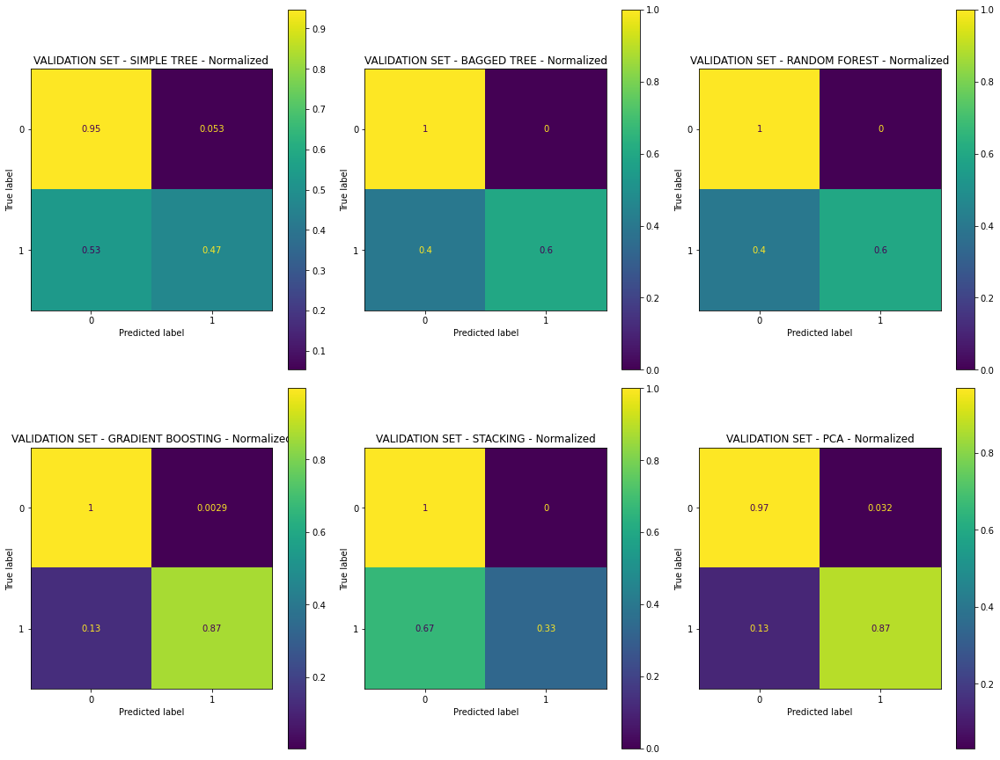

In [173]:
models = [(loaded_simple_tree, "SIMPLE TREE"),
            (loaded_bagged_tree, "BAGGED TREE"),
            (loaded_rf, "RANDOM FOREST"),
            (loaded_gb, "GRADIENT BOOSTING"), 
            (loaded_stacking, "STACKING"), 
            (loaded_pca, "PCA")]
plot_subplots(models, norm='true')


En estas matrices, se muestran los datos normalizados, ya que como el dataset está desbalanceado, no podríamos tener una vision real de los aciertos/fallos de los modelos mostrando los resultados sin normalizar. Con estas matrices, podemos ver que los modelos que más festivos están detectando en el set de validación son el de PCAs y el Gradient Boosting con un 87% de aciertos, seguido de RF con un 60%.

#### 2.2. Análisis de los días peor clasificados
- Indica en una tabla la lista de los días que se han clasificado incorrectamente por cada uno de los modelos considerados
- Comenta las posibles diferencias y semejanzas, intentando buscar una justificación de por qué ha ocurrido el error de clasificación
- Muestra gráficamente los perfiles de 24 horas de los 3 días más difíciles de clasificar para los modelos, comparándolos con lo esperado según el día de la semana correspondiente

In [62]:
indice_dias_malos = []

### Stacking

In [63]:
df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

In [64]:
with open("./models/stacked_reg_model01.pickle", "rb") as f:
    stacked_reg = pickle.load(f)

In [65]:
y_train_stack = stacked_reg.predict(X_train)
y_test_stack = stacked_reg.predict(X_test)

In [66]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# Create a DataFrame with the true labels and predicted labels for the training and test sets
y_train_df = pd.DataFrame({'True label': y_train, 'Predicted label': y_train_stack})
y_test_df = pd.DataFrame({'True label': y_test, 'Predicted label': y_test_stack})

# Filter out the rows where the predicted label does not match the true label
train_errors = y_train_df[y_train_df['True label'] != y_train_df['Predicted label']]
test_errors = y_test_df[y_test_df['True label'] != y_test_df['Predicted label']]

In [67]:
print('\nTest set errors:')
print(test_errors.head())
print(len(test_errors))


Test set errors:
      True label  Predicted label
1698           1                0
581            1                0
504            1                0
2387           1                0
2872           1                0
8


In [68]:
for index, row in test_errors.iterrows():
    festivo_value = df_aju.loc[index, 'FESTIVO']
    diasem_value = df_aju.loc[index, 'DIASEM']
    dia_value = df_aju.loc[index, 'FECHA']
    test_errors.at[index, 'FESTIVO'] = festivo_value
    test_errors.at[index, 'DIASEM'] = diasem_value
    test_errors.at[index, 'FECHA'] = dia_value

indice_dias_malos.extend(test_errors.index.tolist())
test_errors.head()


,True label,Predicted label,FESTIVO,DIASEM,FECHA
1698,1,0,1.0,6.0,2018-09-15
581,1,0,1.0,6.0,2015-08-15
504,1,0,1.0,6.0,2015-05-30
2387,1,0,1.0,6.0,2020-08-15
2872,1,0,1.0,6.0,2021-12-25


In [69]:
# Count the number of occurrences of each DIASEM value in the test_errors DataFrame
counts_by_diasem = test_errors['DIASEM'].value_counts()

# Print the counts by DIASEM
print('Counts by DIASEM:')
print(counts_by_diasem)

Counts by DIASEM:
6.0    5
7.0    1
5.0    1
4.0    1
Name: DIASEM, dtype: int64


#### Random Forest

In [70]:
df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

In [71]:
with open("./models/random_forest_v2.pickle", "rb") as f:
    random_forest_v2 = pickle.load(f)

In [72]:
y_train_rf = random_forest_v2.predict(X_train)
y_test_rf = random_forest_v2.predict(X_test)

In [73]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# Create a DataFrame with the true labels and predicted labels for the training and test sets
y_train_df = pd.DataFrame({'True label': y_train, 'Predicted label': y_train_rf})
y_test_df = pd.DataFrame({'True label': y_test, 'Predicted label': y_test_rf})

# Filter out the rows where the predicted label does not match the true label
train_errors = y_train_df[y_train_df['True label'] != y_train_df['Predicted label']]
test_errors = y_test_df[y_test_df['True label'] != y_test_df['Predicted label']]

In [74]:
print('\nTest set errors:')
print(test_errors.head())
print(len(test_errors))


Test set errors:
      True label  Predicted label
1698           1                0
581            1                0
504            1                0
2387           1                0
2872           1                0
8


In [75]:
for index, row in test_errors.iterrows():
    festivo_value = df_aju.loc[index, 'FESTIVO']
    diasem_value = df_aju.loc[index, 'DIASEM']
    dia_value = df_aju.loc[index, 'FECHA']
    test_errors.at[index, 'FESTIVO'] = festivo_value
    test_errors.at[index, 'DIASEM'] = diasem_value
    test_errors.at[index, 'FECHA'] = dia_value
indice_dias_malos.extend(test_errors.index.tolist())

test_errors.head()

,True label,Predicted label,FESTIVO,DIASEM,FECHA
1698,1,0,1.0,6.0,2018-09-15
581,1,0,1.0,6.0,2015-08-15
504,1,0,1.0,6.0,2015-05-30
2387,1,0,1.0,6.0,2020-08-15
2872,1,0,1.0,6.0,2021-12-25


In [76]:
# Count the number of occurrences of each DIASEM value in the test_errors DataFrame
counts_by_diasem = test_errors['DIASEM'].value_counts()

# Print the counts by DIASEM
print('Counts by DIASEM:')
print(counts_by_diasem)

Counts by DIASEM:
6.0    5
7.0    1
5.0    1
4.0    1
Name: DIASEM, dtype: int64


### Gradient boosting

In [77]:
df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

In [78]:
with open("./models/gradient_boostingv2.pickle", "rb") as f:
    gradien_boosting = pickle.load(f)

In [79]:
y_train_rf = gradien_boosting.predict(X_train)
y_test_rf = gradien_boosting.predict(X_test)

In [80]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# Create a DataFrame with the true labels and predicted labels for the training and test sets
y_train_df = pd.DataFrame({'True label': y_train, 'Predicted label': y_train_rf})
y_test_df = pd.DataFrame({'True label': y_test, 'Predicted label': y_test_rf})

# Filter out the rows where the predicted label does not match the true label
train_errors = y_train_df[y_train_df['True label'] != y_train_df['Predicted label']]
test_errors = y_test_df[y_test_df['True label'] != y_test_df['Predicted label']]

In [81]:
print('\nTest set errors:')
print(test_errors.head())
print(len(test_errors))


Test set errors:
      True label  Predicted label
1698           1                0
581            1                0
1909           1                0
504            1                0
363            1                0
23


In [82]:
for index, row in test_errors.iterrows():
    festivo_value = df_aju.loc[index, 'FESTIVO']
    diasem_value = df_aju.loc[index, 'DIASEM']
    dia_value = df_aju.loc[index, 'FECHA']
    test_errors.at[index, 'FESTIVO'] = festivo_value
    test_errors.at[index, 'DIASEM'] = diasem_value
    test_errors.at[index, 'FECHA'] = dia_value
indice_dias_malos.extend(test_errors.index.tolist())

test_errors.head()

,True label,Predicted label,FESTIVO,DIASEM,FECHA
1698,1,0,1.0,6.0,2018-09-15
581,1,0,1.0,6.0,2015-08-15
1909,1,0,1.0,5.0,2019-04-19
504,1,0,1.0,6.0,2015-05-30
363,1,0,1.0,2.0,2015-01-06


In [83]:
# Count the number of occurrences of each DIASEM value in the test_errors DataFrame
counts_by_diasem = test_errors['DIASEM'].value_counts()

# Print the counts by DIASEM
print('Counts by DIASEM:')
print(counts_by_diasem)

Counts by DIASEM:
6.0    5
5.0    5
1.0    5
2.0    4
3.0    3
7.0    1
Name: DIASEM, dtype: int64


### Bagged Tree

In [84]:
df_aju = read_data()
INPUTS, OUTPUT, X_train, X_test, y_train, y_test = split_dataset()

In [85]:
with open("./models/bagged_tree_v2.pickle", "rb") as f:
    bagged_tree = pickle.load(f)

In [86]:
y_train_rf = bagged_tree.predict(X_train)
y_test_rf = bagged_tree.predict(X_test)

In [87]:
#--------------------------NO ESCRIBAS LÍNEAS DE CÓDIGO MÁS LARGAS QUE LO QUE OCUPA ESTA LÍNEA -----------------------------|
# Create a DataFrame with the true labels and predicted labels for the training and test sets
y_train_df = pd.DataFrame({'True label': y_train, 'Predicted label': y_train_rf})
y_test_df = pd.DataFrame({'True label': y_test, 'Predicted label': y_test_rf})

# Filter out the rows where the predicted label does not match the true label
train_errors = y_train_df[y_train_df['True label'] != y_train_df['Predicted label']]
test_errors = y_test_df[y_test_df['True label'] != y_test_df['Predicted label']]

In [88]:
print('\nTest set errors:')
print(test_errors.head())
print(len(test_errors))


Test set errors:
      True label  Predicted label
1698           1                0
581            1                0
504            1                0
1253           0                1
2387           1                0
9


In [89]:
for index, row in test_errors.iterrows():
    festivo_value = df_aju.loc[index, 'FESTIVO']
    diasem_value = df_aju.loc[index, 'DIASEM']
    dia_value = df_aju.loc[index, 'FECHA']
    test_errors.at[index, 'FESTIVO'] = festivo_value
    test_errors.at[index, 'DIASEM'] = diasem_value
    test_errors.at[index, 'FECHA'] = dia_value
indice_dias_malos.extend(test_errors.index.tolist())
test_errors.head()

,True label,Predicted label,FESTIVO,DIASEM,FECHA
1698,1,0,1.0,6.0,2018-09-15
581,1,0,1.0,6.0,2015-08-15
504,1,0,1.0,6.0,2015-05-30
1253,0,1,0.0,7.0,2017-06-25
2387,1,0,1.0,6.0,2020-08-15


In [90]:
# Count the number of occurrences of each DIASEM value in the test_errors DataFrame
counts_by_diasem = test_errors['DIASEM'].value_counts()

# Print the counts by DIASEM
print('Counts by DIASEM:')
print(counts_by_diasem)

Counts by DIASEM:
6.0    5
7.0    2
1.0    1
5.0    1
Name: DIASEM, dtype: int64


A continuación podemos observar en la tabla de abajo, el número de días que ha clasificado incorrectamente cada modelo para cada día de la semana.

|         | Stacking    | Random Forest | Gradient Boosting | Bagged Tree |
|---------|-------------|---------------|-------------------|-------------|
| Dia 1   | 2           | 0             | 5                 | 1           |
| Dia 2   | 0           | 0          | 4                  | 0           |
| Dia 3   | 0           | 0          | 3                  | 0           |
| Dia 4   | 0           | 1          | 0                  | 0           |
| Dia 5   | 2           | 1          | 5                  | 1           |
| Dia 6   | 5           | 5          | 5                  | 5           |
| Dia 7   | 2           | 1          | 1                  | 2           |


Vemos que los dias que menos errores han cometido son los martes, miercoles y jueves, mientras que los dias que más errores han cometido son los lunes, viernes y sábado.

- Muestra gráficamente los perfiles de 24 horas de los 3 días más difíciles de clasificar para los modelos, comparándolos con lo esperado según el día de la semana correspondiente

In [95]:
df_selected = df_aju.loc[indice_dias_malos]
df_selected.head()

,FECHA,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,...,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,FESTIVO,TMIN,TMAX
1698,2018-09-15,0.037157,0.034392,0.032625,0.031984,0.031603,0.032042,0.033675,0.035665,0.039242,...,0.047375,0.049886,0.048206,0.043791,0.039325,9,6,1,21.6,29.7
581,2015-08-15,0.038045,0.034872,0.032762,0.031755,0.031476,0.031918,0.033586,0.034543,0.038440,...,0.048276,0.049129,0.050123,0.045807,0.041846,8,6,1,21.4,29.1
504,2015-05-30,0.037253,0.034279,0.032447,0.031560,0.031418,0.032238,0.033361,0.034527,0.039621,...,0.047161,0.047713,0.049249,0.045416,0.040743,5,6,1,18.3,27.5
2387,2020-08-15,0.037837,0.035099,0.033299,0.032365,0.032168,0.032530,0.034100,0.035147,0.038936,...,0.045483,0.047178,0.048793,0.044791,0.040792,8,6,1,21.3,29.7
2872,2021-12-25,0.037186,0.035602,0.034121,0.033099,0.032976,0.033318,0.034506,0.036021,0.039232,...,0.049594,0.049206,0.047379,0.043234,0.039343,12,6,1,14.2,24.5


In [98]:
festivo = df_selected['FESTIVO'].value_counts()
print('Counts by FESTIVO:')
print(festivo)

diasem = df_selected['DIASEM'].value_counts()
print('Counts by diasem:')
print(diasem)

Counts by FESTIVO:
1    44
0     4
Name: FESTIVO, dtype: int64
Counts by diasem:
6    20
5     8
1     6
7     5
2     4
3     3
4     2
Name: DIASEM, dtype: int64


Vemos que en el df original, la mayoria de las observacion mal clasificadas son festivo, por lo que nuestros modelos no han sido capaces de detectarlos como festivos. Esto puede deberse a que los festivos no son tan distintos de los dias laborables, por lo que los modelos no han sido capaces de detectarlos como festivos. Por otro lado, vemos que el dia que más errores ha cometido es el sábado con casi la mitad del total. Esto puede deberse a que los sábados, la gente ya no madruga ni consume como un dia laboral, y el que sea fiesta o no no varia su consumo.

In [99]:
df_selected.columns

Index(['FECHA', 'CR00', 'CR01', 'CR02', 'CR03', 'CR04', 'CR05', 'CR06', 'CR07',
       'CR08', 'CR09', 'CR10', 'CR11', 'CR12', 'CR13', 'CR14', 'CR15', 'CR16',
       'CR17', 'CR18', 'CR19', 'CR20', 'CR21', 'CR22', 'CR23', 'MES', 'DIASEM',
       'FESTIVO', 'TMIN', 'TMAX'],
      dtype='object')

Seleccionamos los dias que son festivos pero que se han marcado como no festivos 

In [118]:
df_selected = df_selected[df_selected['FESTIVO'] == 1]

In [133]:
df_not_selected = df_aju.loc[~df_aju.index.isin(indice_dias_malos)]
df_not_selected = df_not_selected[df_not_selected['FESTIVO'] == 0]
df_not_selected.head()

,FECHA,CR00,CR01,CR02,CR03,CR04,CR05,CR06,CR07,CR08,...,CR19,CR20,CR21,CR22,CR23,MES,DIASEM,FESTIVO,TMIN,TMAX
1,2014-01-02,0.033950,0.030996,0.029517,0.028966,0.029165,0.030150,0.032944,0.036510,0.041196,...,0.055820,0.054451,0.051482,0.046145,0.040880,1,4,0,12.0,20.1
2,2014-01-03,0.035463,0.032112,0.030292,0.029521,0.029450,0.030515,0.033188,0.036656,0.041052,...,0.055230,0.053520,0.050286,0.045412,0.040025,1,5,0,13.2,21.0
3,2014-01-04,0.035959,0.032772,0.031034,0.030178,0.030135,0.030782,0.032598,0.034982,0.039299,...,0.053757,0.052620,0.049973,0.044970,0.040386,1,6,0,14.4,23.4
4,2014-01-05,0.037506,0.034148,0.031878,0.031126,0.030930,0.031604,0.033066,0.034803,0.038758,...,0.052902,0.051481,0.049655,0.045730,0.040905,1,7,0,12.8,23.1
6,2014-01-07,0.033978,0.031488,0.030125,0.029326,0.029369,0.030591,0.033306,0.037551,0.041920,...,0.055453,0.054602,0.051538,0.045112,0.039318,1,2,0,12.6,21.6


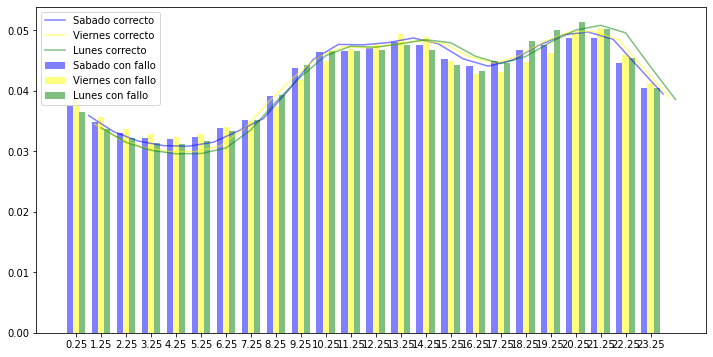

In [134]:
bar_width = 0.25

# Filter the dataframe by DIASEM values
df_diasem_6 = df_selected[df_selected['DIASEM'] == 6]
df_diasem_5 = df_selected[df_selected['DIASEM'] == 5]
df_diasem_1 = df_selected[df_selected['DIASEM'] == 1]

# Calculate the mean for each hour
mean_diasem_6 = df_diasem_6.iloc[:, 1:25].mean()
mean_diasem_5 = df_diasem_5.iloc[:, 1:25].mean()
mean_diasem_1 = df_diasem_1.iloc[:, 1:25].mean()

# Filter the dataframe by non-DIASEM values
df_not_diasem_6 = df_not_selected[df_not_selected['DIASEM'] == 6]
df_not_diasem_5 = df_not_selected[df_not_selected['DIASEM'] == 5]
df_not_diasem_1 = df_not_selected[df_not_selected['DIASEM'] == 1]

# Calculate the mean for each hour
mean_not_diasem_6 = df_not_diasem_6.iloc[:, 1:25].mean()
mean_not_diasem_5 = df_not_diasem_5.iloc[:, 1:25].mean()
mean_not_diasem_1 = df_not_diasem_1.iloc[:, 1:25].mean()

# Create x values for bars
x_diasem_6 = np.arange(len(mean_diasem_6.index))
x_diasem_5 = [x + bar_width for x in x_diasem_6]
x_diasem_1 = [x + bar_width for x in x_diasem_5]
x_not_diasem_6 = [x + bar_width for x in x_diasem_1]
x_not_diasem_5 = [x + bar_width for x in x_not_diasem_6]
x_not_diasem_1 = [x + bar_width for x in x_not_diasem_5]

# Create the figure and axis objects
fig, ax = plt.subplots(figsize=(12,6))

# Plot bars for each value of DIASEM
ax.bar(x_diasem_6, mean_diasem_6.values, color='blue', alpha=0.5, width=bar_width, label='Sabado con fallo')
ax.bar(x_diasem_5, mean_diasem_5.values, color='yellow', alpha=0.5, width=bar_width, label='Viernes con fallo')
ax.bar(x_diasem_1, mean_diasem_1.values, color='green', alpha=0.5, width=bar_width, label='Lunes con fallo')

# Plot lines for each value of non-DIASEM
ax.plot(x_not_diasem_6, mean_not_diasem_6.values, color='blue', alpha=0.5, label='Sabado correcto')
ax.plot(x_not_diasem_5, mean_not_diasem_5.values, color='yellow', alpha=0.5, label='Viernes correcto')
ax.plot(x_not_diasem_1, mean_not_diasem_1.values, color='green', alpha=0.5, label='Lunes correcto')

# Set x-axis tick labels
ax.set_xticks(x_diasem_5)
plt.legend()
plt.show()

Como podemos ver tenemos los dias festivos(viernes, sabado y luenes) que son los que mas se fallan a la hora de clasificarlos. En las barras tenemos el consumo por hora y por dia de los que originalmente son festivos pero los clasificamos como no festivos. En las lineas tenemos la media de consumo de los mismo dias, pero bien clasificados y cuando festivo es igual a 0, podemos ver que el consumo es muy similar, por lo que los modelos no han sido capaces de detectarlos y clasificarlos correctamente.

# Anexo
## Tasa de error según el día de la semana

In [ ]:
def calculate_metrics(estimator, X_train, X_test, y_train, y_test):
    clf = estimator
    y_train_pred = clf.predict(X_train[INPUTS_BT]).tolist()
    y_test_pred = clf.predict(X_test[INPUTS_BT]).tolist()

    # main metrics
    acc_tr = metrics.accuracy_score(y_train,y_train_pred)
    acc_ts = metrics.accuracy_score(y_test,y_test_pred)

    acc_bal_tr = metrics.balanced_accuracy_score(y_train,y_train_pred)
    acc_bal_ts = metrics.balanced_accuracy_score(y_test,y_test_pred)

    dfacc =  pd.DataFrame([[acc_tr, acc_ts], [acc_bal_tr, acc_bal_ts]], index= ['Accuracy', 'Balanced accuracy'],  columns=['TR', 'TS'])
    print(dfacc)

    print('\nMETRICS TRAINING:')
    CT.confusion_matrix(y_train, y_train_pred, labels=[1,0])
    print('\nMETRICS TEST SET:')
    CT.confusion_matrix(y_test, y_test_pred, labels=[1,0])

**Lunes**

In [ ]:
X_train_l = X_train[X_train.DIASEM == 1]
X_test_l = X_test[X_test.DIASEM == 1]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
loaded_bt = pickle.load(open("./models/bagged_tree_v2.pickle", "rb"))
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR        TS
Accuracy           0.990476  0.989130
Balanced accuracy  0.906250  0.994253

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 13   3
         0  0 299

Accuracy: 0.99
No Information Rate: 0.91
P-Value [Acc > NIR]: 0.0
Kappa: 0.89
Mcnemar's Test P-Value: 0.25
Sensitivity: 1.0
Specificity: 0.81
Precision: 1.0
Recall: 0.81
Prevalence: 0.95
Detection Rate: 0.95
Detection prevalence: 0.96
Balanced accuracy: 0.91
F1 Score: 0.9
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  5  0
         0  1 86

Accuracy: 0.99
No Information Rate: 0.89
P-Value [Acc > NIR]: 0.04
Kappa: 0.9
Mcnemar's Test P-Value: 1.0
Sensitivity: 0.99
Specificity: 1.0
Precision: 0.83
Recall: 1.0
Prevalence: 0.95
Detection Rate: 0.93
Detection prevalence: 0.93
Balanced accuracy: 0.99
F1 Score: 0.91
Positive label: 1


**Martes**

In [ ]:
X_train_l = X_train[X_train.DIASEM == 2]
X_test_l = X_test[X_test.DIASEM == 2]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                    TR   TS
Accuracy           1.0  1.0
Balanced accuracy  1.0  1.0

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 18   0
         0  0 312

Accuracy: 1.0
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.95
Detection Rate: 0.95
Detection prevalence: 0.95
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  4  0
         0  0 74

Accuracy: 1.0
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.02
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.95
Detection Rate: 0.95
Detection prevalence: 0.95
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1


**Miércoles**

In [ ]:
X_train_l = X_train[X_train.DIASEM == 3]
X_test_l = X_test[X_test.DIASEM == 3]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                    TR   TS
Accuracy           1.0  1.0
Balanced accuracy  1.0  1.0

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 11   0
         0  0 329

Accuracy: 1.0
No Information Rate: 0.94
P-Value [Acc > NIR]: 0.0
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.97
Detection Rate: 0.97
Detection prevalence: 0.97
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  3  0
         0  0 69

Accuracy: 1.0
No Information Rate: 0.92
P-Value [Acc > NIR]: 0.05
Kappa: 1.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 1.0
Precision: 1.0
Recall: 1.0
Prevalence: 0.96
Detection Rate: 0.96
Detection prevalence: 0.96
Balanced accuracy: 1.0
F1 Score: 1.0
Positive label: 1


**Jueves**

In [ ]:
X_train_l = X_train[X_train.DIASEM == 4]
X_test_l = X_test[X_test.DIASEM == 4]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR   TS
Accuracy           0.997024  1.0
Balanced accuracy  0.975000  1.0

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 19   1
         0  0 316

Accuracy: 1.0
No Information Rate: 0.89
P-Value [Acc > NIR]: 0.0
Kappa: 0.97
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.95
Precision: 1.0
Recall: 0.95
Prevalence: 0.94
Detection Rate: 0.94
Detection prevalence: 0.94
Balanced accuracy: 0.98
F1 Score: 0.97
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  0  0
         0  0 78

Accuracy: 1.0
No Information Rate: 1.0
P-Value [Acc > NIR]: 1.0
Kappa: nan
Mcnemar's Test P-Value: 1.0
Precision: 0.5
Recall: 0.5
Balanced accuracy: 1.0
F1 Score: 0.5
Positive label: 1


**Viernes**

In [ ]:
X_train_l = X_train[X_train.DIASEM == 5]
X_test_l = X_test[X_test.DIASEM == 5]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR        TS
Accuracy           0.996988  0.988095
Balanced accuracy  0.972222  0.900000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1 17   1
         0  0 314

Accuracy: 1.0
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.0
Kappa: 0.97
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.94
Precision: 1.0
Recall: 0.94
Prevalence: 0.95
Detection Rate: 0.95
Detection prevalence: 0.95
Balanced accuracy: 0.97
F1 Score: 0.97
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  4  1
         0  0 79

Accuracy: 0.99
No Information Rate: 0.9
P-Value [Acc > NIR]: 0.04
Kappa: 0.88
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.8
Precision: 1.0
Recall: 0.8
Prevalence: 0.94
Detection Rate: 0.94
Detection prevalence: 0.95
Balanced accuracy: 0.9
F1 Score: 0.89
Positive label: 1


**Sábado**

In [ ]:
X_train_l = X_train[X_train.DIASEM == 6]
X_test_l = X_test[X_test.DIASEM == 6]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR        TS
Accuracy           0.987578  0.945652
Balanced accuracy  0.750000  0.500000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  4   4
         0  0 314

Accuracy: 0.99
No Information Rate: 0.96
P-Value [Acc > NIR]: 0.1
Kappa: 0.66
Mcnemar's Test P-Value: 0.12
Sensitivity: 1.0
Specificity: 0.5
Precision: 1.0
Recall: 0.5
Prevalence: 0.98
Detection Rate: 0.98
Detection prevalence: 0.99
Balanced accuracy: 0.75
F1 Score: 0.67
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  0  5
         0  0 87

Accuracy: 0.95
No Information Rate: 0.95
P-Value [Acc > NIR]: 0.62
Kappa: 0.0
Mcnemar's Test P-Value: 0.06
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.95
Detection Rate: 0.95
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1


**Domingo**

In [ ]:
X_train_l = X_train[X_train.DIASEM == 7]
X_test_l = X_test[X_test.DIASEM == 7]
y_train_l = y_train[y_train.index.isin(X_train_l.index)]
y_test_l = y_test[y_test.index.isin(X_test_l.index)]
calculate_metrics(loaded_bt, X_train_l[INPUTS_BT], X_test_l[INPUTS_BT], y_train_l, y_test_l)

                         TR      TS
Accuracy           0.996951  0.9875
Balanced accuracy  0.500000  0.5000

METRICS TRAINING:
Confusion Matrix and Statistics
	   Prediction
 Reference  1   0
         1  0   1
         0  0 327

Accuracy: 1.0
No Information Rate: 1.0
P-Value [Acc > NIR]: 0.74
Kappa: 0.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 1.0
Detection Rate: 1.0
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1

METRICS TEST SET:
Confusion Matrix and Statistics
	   Prediction
 Reference  1  0
         1  0  1
         0  0 79

Accuracy: 0.99
No Information Rate: 0.99
P-Value [Acc > NIR]: 0.74
Kappa: 0.0
Mcnemar's Test P-Value: 1.0
Sensitivity: 1.0
Specificity: 0.0
Precision: 0.0
Recall: 0.0
Prevalence: 0.99
Detection Rate: 0.99
Detection prevalence: 1.0
Balanced accuracy: 0.5
F1 Score: 0.0
Positive label: 1
